## Statistical Methods in AI (Spring 2025)
### Assignment - 1

### Name -  Mayank Mittal
### Roll Number - 2022101094

### Importing important libraries

In [27]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.impute import SimpleImputer
plt.style.use('seaborn')
sns.set_palette("husl")

### 2.1 Exploratory Data Analysis (EDA)

In [28]:
data = pd.read_csv('Food_Delivery_Times.csv')

In [29]:
data.head()

,Order_ID,Distance_km,Weather,Traffic_Level,Time_of_Day,Vehicle_Type,Preparation_Time_min,Courier_Experience_yrs,Delivery_Time_min
0,522,7.93,Windy,Low,Afternoon,Scooter,12,1.0,43
1,738,16.42,Clear,Medium,Evening,Bike,20,2.0,84
2,741,9.52,Foggy,Low,Night,Scooter,28,1.0,59
3,661,7.44,Rainy,Medium,Afternoon,Scooter,5,1.0,37
4,412,19.03,Clear,Low,Morning,Bike,16,5.0,68


In [30]:
data.columns

Index(['Order_ID', 'Distance_km', 'Weather', 'Traffic_Level', 'Time_of_Day',
       'Vehicle_Type', 'Preparation_Time_min', 'Courier_Experience_yrs',
       'Delivery_Time_min'],
      dtype='object')

In [31]:
data.describe()

,Order_ID,Distance_km,Preparation_Time_min,Courier_Experience_yrs,Delivery_Time_min
count,1000.000000,1000.000000,1000.000000,970.000000,1000.000000
mean,500.500000,10.059970,16.982000,4.579381,56.732000
std,288.819436,5.696656,7.204553,2.914394,22.070915
min,1.000000,0.590000,5.000000,0.000000,8.000000
25%,250.750000,5.105000,11.000000,2.000000,41.000000
50%,500.500000,10.190000,17.000000,5.000000,55.500000
75%,750.250000,15.017500,23.000000,7.000000,71.000000
max,1000.000000,19.990000,29.000000,9.000000,153.000000


In [32]:
data.shape

(1000, 9)

In [33]:
data['Weather'].unique()

array(['Windy', 'Clear', 'Foggy', 'Rainy', 'Snowy', nan], dtype=object)

In [34]:
print("Missing values:\n", data.isnull().sum())

Missing values:
 Order_ID                   0
Distance_km                0
Weather                   30
Traffic_Level             30
Time_of_Day               30
Vehicle_Type               0
Preparation_Time_min       0
Courier_Experience_yrs    30
Delivery_Time_min          0
dtype: int64


<Axes: >

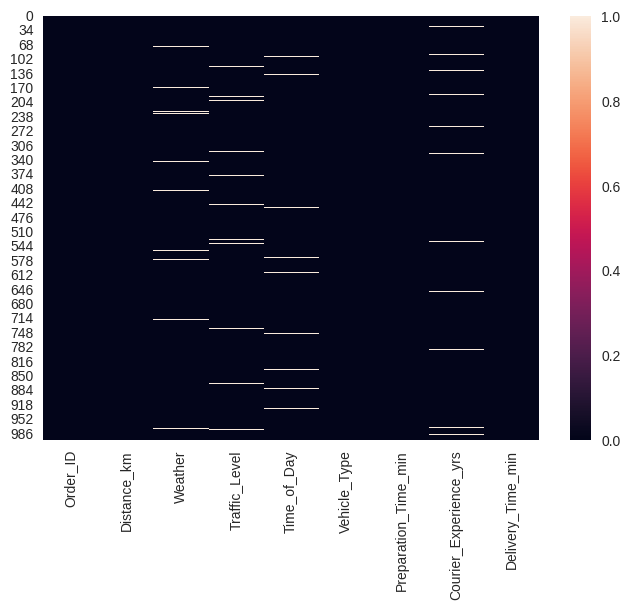

In [35]:
sns.heatmap(data.isna())

In [36]:
numerical_columns = ['Distance_km', 'Preparation_Time_min','Courier_Experience_yrs', 'Delivery_Time_min']
categorical_columns = ['Weather', 'Traffic_Level', 'Time_of_Day', 'Vehicle_Type']

numerical_imputer = SimpleImputer(strategy='mean')
categorical_imputer = SimpleImputer(strategy='most_frequent')
data[numerical_columns] = numerical_imputer.fit_transform(data[numerical_columns])
data[categorical_columns] = categorical_imputer.fit_transform(data[categorical_columns])
print("\nMissing values after imputation:\n", data.isnull().sum())


Missing values after imputation:
 Order_ID                  0
Distance_km               0
Weather                   0
Traffic_Level             0
Time_of_Day               0
Vehicle_Type              0
Preparation_Time_min      0
Courier_Experience_yrs    0
Delivery_Time_min         0
dtype: int64


In [37]:
print(sum(data['Delivery_Time_min'])/1000)

56.732


In [38]:
data['Traffic_Level'].unique()

array(['Low', 'Medium', 'High'], dtype=object)

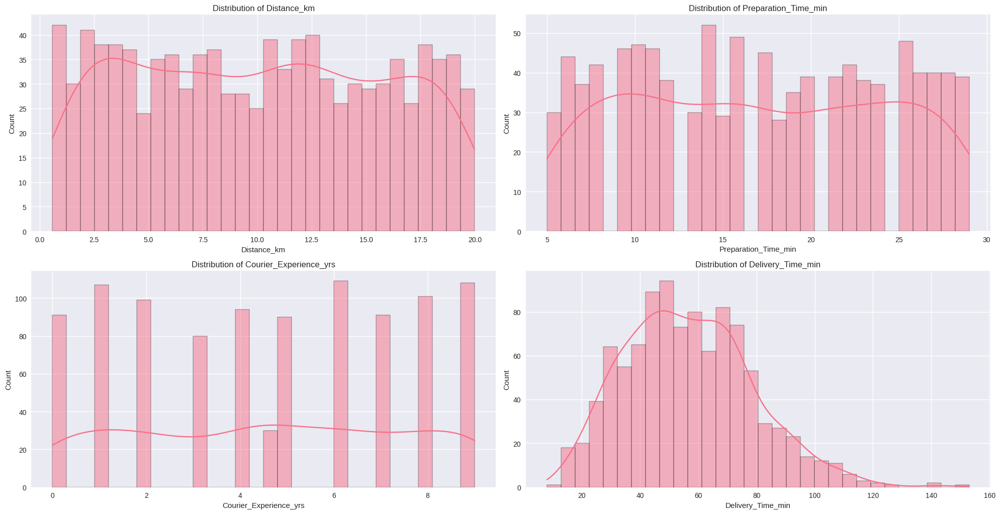

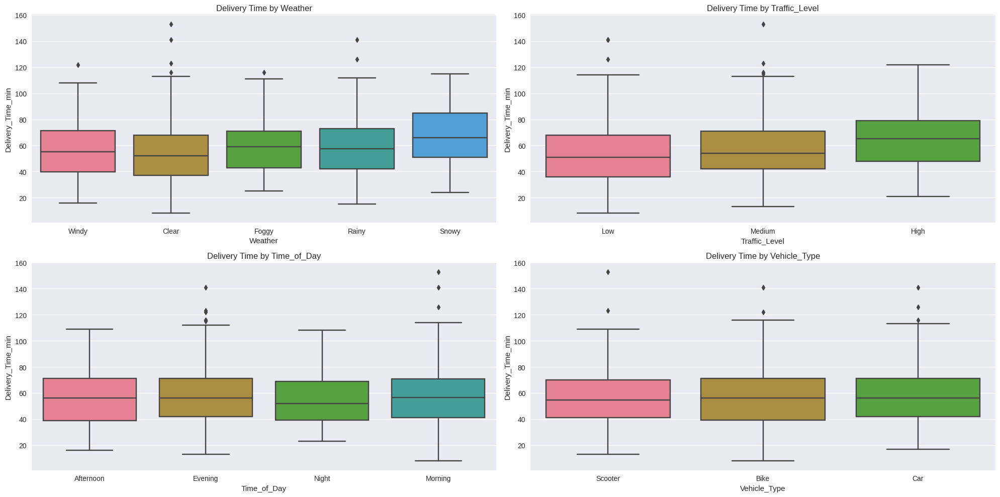

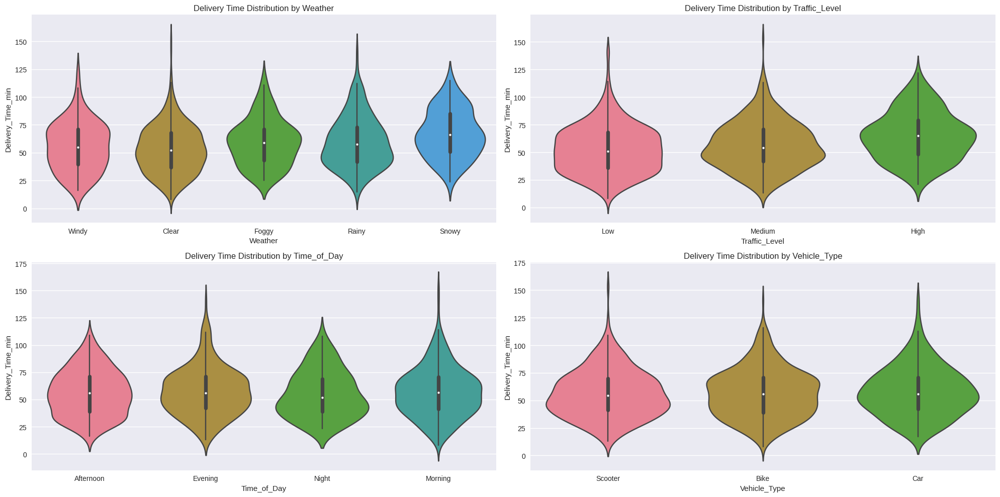

In [39]:
plt.figure(figsize=(20, 15))
    
numerical_features = ['Distance_km', 'Preparation_Time_min', 'Courier_Experience_yrs', 'Delivery_Time_min']
    
for i, feature in enumerate(numerical_features, 1):
        plt.subplot(3, 2, i)
        sns.histplot(data=data, x=feature, bins=30, kde=True)
        plt.title(f'Distribution of {feature}')
    
plt.tight_layout()
plt.show()
    
# Box plots for categorical features
plt.figure(figsize=(20, 10))
categorical_features = ['Weather', 'Traffic_Level', 'Time_of_Day', 'Vehicle_Type']
    
for i, feature in enumerate(categorical_features, 1):
        plt.subplot(2, 2, i)
        sns.boxplot(data=data, x=feature, y='Delivery_Time_min')
        plt.title(f'Delivery Time by {feature}')
    
plt.tight_layout()
plt.show()
    
# Violin plots for categorical features
plt.figure(figsize=(20, 10))
    
for i, feature in enumerate(categorical_features, 1):
        plt.subplot(2, 2, i)
        sns.violinplot(data=data, x=feature, y='Delivery_Time_min')
        plt.title(f'Delivery Time Distribution by {feature}')
    
plt.tight_layout()
plt.show()



In [40]:
le = LabelEncoder()
categorical_columns = ['Weather', 'Traffic_Level', 'Time_of_Day', 'Vehicle_Type']
    
for col in categorical_columns:
    data[col] = le.fit_transform(data[col])
    

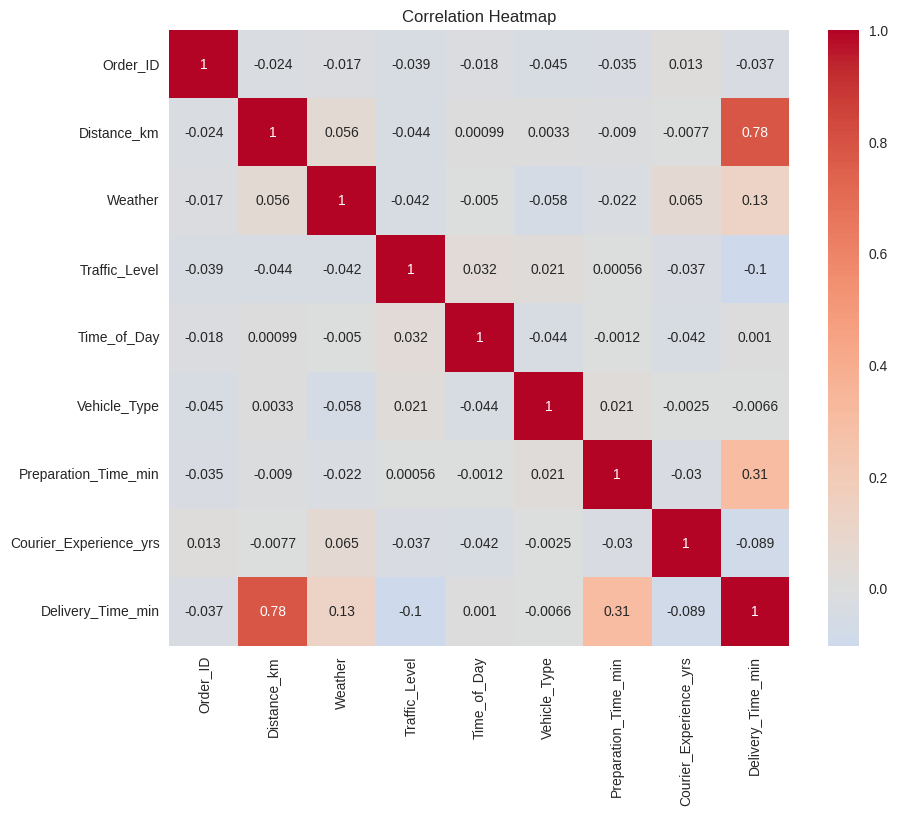

In [41]:
# Correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(data.corr(), annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Heatmap')
plt.show()

In [42]:
time_of_day_mapping = {
    0: 'Morning',
    1: 'Afternoon',
    2: 'Evening',
    3: 'Night'
}

weather_mapping = {
    0: 'Clear',
    1: 'Foggy',
    2: 'Rainy',
    3: 'Snowy',
    4: 'Windy'
}

traffic_level_mapping = {
    0: 'High',
    1: 'Low',
    2: 'Medium'
}

vehicle_type_mapping = {
    0: 'Bike',
    1: 'Car',
    2: 'Scooter',
}

KeyboardInterrupt: 

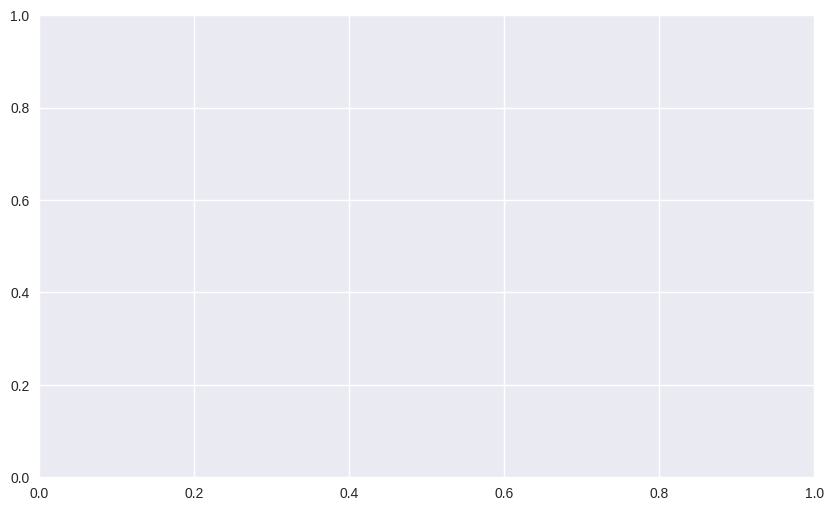

In [43]:
plot_data = data.copy()
    
# Map encoded values to actual categories
plot_data['Time_of_Day'] = plot_data['Time_of_Day'].map(time_of_day_mapping)
plot_data['Weather'] = plot_data['Weather'].map(weather_mapping)
plot_data['Traffic_Level'] = plot_data['Traffic_Level'].map(traffic_level_mapping)
plot_data['Vehicle_Type'] = plot_data['Vehicle_Type'].map(vehicle_type_mapping)
    
# Add regression line
plt.figure(figsize=(10, 6))
sns.regplot(data=plot_data, 
                x='Courier_Experience_yrs', 
                y='Delivery_Time_min',
                scatter=False, 
                color='red')
plt.show()

# Feature relationships with delivery time
plt.figure(figsize=(12, 6))
sns.scatterplot(data=plot_data, 
                    x='Distance_km', 
                    y='Delivery_Time_min',
                    hue='Traffic_Level', 
                    size='Preparation_Time_min',
                    sizes=(50, 200), 
                    alpha=0.6)
plt.title('Delivery Time vs Distance (colored by Traffic Level, size by Preparation Time)')
plt.show()

# Time of day analysis
plt.figure(figsize=(12, 6))
sns.violinplot(data=plot_data, 
                   x='Time_of_Day', 
                   y='Delivery_Time_min',
                   hue='Weather')
plt.title('Delivery Time Distribution by Time of Day and Weather')
plt.xticks(rotation=45)
plt.show()

# Joint plot for Distance and Delivery Time
sns.jointplot(data=plot_data, 
                  x='Distance_km', 
                  y='Delivery_Time_min',
                  kind='reg', 
                  height=8)
plt.show()

# Experience vs Delivery Time by Weather Conditions
g = sns.lmplot(data=plot_data, 
                   x='Courier_Experience_yrs', 
                   y='Delivery_Time_min',
                   col='Weather', 
                   height=6, 
                   aspect=0.8)
g.fig.suptitle('Experience vs Delivery Time by Weather', y=1.05)
plt.show()

# Stacked analysis of categorical features
plt.figure(figsize=(12, 6))
avg_delivery_time = plot_data.groupby(['Vehicle_Type', 'Traffic_Level'])['Delivery_Time_min'].mean().unstack()
sns.heatmap(avg_delivery_time, annot=True, fmt='.1f', cmap='YlOrRd')
plt.title('Average Delivery Time by Vehicle Type and Traffic Level')
plt.show()


### Splitting the datasets

In [18]:
X = data.drop(['Order_ID', 'Delivery_Time_min'], axis=1)
y = data['Delivery_Time_min']
    
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
    
X_test, X_val, y_test, y_val = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)
    
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
X_val_scaled = scaler.transform(X_val)
    
print("Training set shape:", X_train_scaled.shape)
print("Testing set shape:", X_test_scaled.shape)
print("Validation set shape:", X_val_scaled.shape)

Training set shape: (700, 7)
Testing set shape: (150, 7)
Validation set shape: (150, 7)


### Observations and Insights:- 

1) Orders are being taken uniformly from all areas with almost same range of 25-40
2) Plot of Preparation_time vs count shows 6 clusters of histogram depicting maybe 6 types of food items being made and delivered thus having almost similar preparation time
3) Average and most probable Delivery_time is around 56 min as shown in the distribution
4) Can see that median delivery time is highest in Snowy weather followed by Rainy, foggy and windy and least in clear weather as obvious.
5) Can see same in Traffic level with median delivery time is high in high traffic followed by medium and low.
6) Time_of_day and Vehicle Type has no effect on Delivery time as seen in plot.
7) Delivery time in min has positive correlation with distance in km as it increases with increase in other which is very obvious
8) Delivery time in mins has negative correlation with Courier Experience in years as if experience is more , it will do delivery faster than a
   new delivery agent.
9) We can see that Time_of_the _day , Courier_Experience and Weather has almost zero correlation with Deliver_time_in mins
10) We can see from heatmap that average delivery time in mins is highest with Car in high traffic and least with Scooter in low traffic as expected.

### 2.2 Linear Regression with Gradient Descent 

In [19]:
from sklearn.metrics import r2_score
from prettytable import PrettyTable

In [20]:
class LinearRegression:
    def __init__(self, init_method='zero'):
        self.weights = None
        self.bias = None
        self.init_method = init_method
        self.train_losses = []
        self.val_losses = []
        
    def initialize_parameters(self, n_features):
        if self.init_method == 'zero':
            self.weights = np.zeros(n_features)
            self.bias = 0
        elif self.init_method == 'random':  # random initialization
            self.weights = np.random.randn(n_features) * 0.01
            self.bias = np.random.randn() * 0.01
    
    def compute_predictions(self, X):
        return np.dot(X, self.weights) + self.bias
    
    def compute_loss(self, X, y):
        predictions = self.compute_predictions(X)
        mse = np.mean((predictions - y) ** 2)
        return mse
    
    def compute_gradients(self, X, y, predictions):
        m = len(y)  # No. of training examples
        dw = (1/m) * np.dot(X.T, (predictions - y))
        db = (1/m) * np.sum(predictions - y)
        return dw, db
    
    def batch_gradient_descent(self, X_train, y_train, X_val, y_val, learning_rate=0.05, n_iterations=1000):
        self.initialize_parameters(X_train.shape[1])
        self.train_losses = []
        self.val_losses = []
        
        for i in range(n_iterations):
            # will update parameters taking whole tarining dataset at a time 
            predictions = self.compute_predictions(X_train)
            dw, db = self.compute_gradients(X_train, y_train, predictions)
            
            # Update parameters
            self.weights -= learning_rate * dw
            self.bias -= learning_rate * db
            
            # Compute and store losses
            if i % 10 == 0:
                train_loss = self.compute_loss(X_train, y_train)
                val_loss = self.compute_loss(X_val, y_val)
                self.train_losses.append(train_loss)
                self.val_losses.append(val_loss)
    
    def stochastic_gradient_descent(self, X_train, y_train, X_val, y_val, learning_rate=0.05, n_iterations=1000):
        self.initialize_parameters(X_train.shape[1])
        self.train_losses = []
        self.val_losses = []
        
        for i in range(n_iterations):
            idx = np.random.randint(0, len(y_train))
            X_sample = X_train[idx:idx+1]
            y_sample = y_train[idx:idx+1]
            
            predictions = self.compute_predictions(X_sample)
            dw, db = self.compute_gradients(X_sample, y_sample, predictions)
            
            # Update parameters
            self.weights -= learning_rate * dw
            self.bias -= learning_rate * db
            
            # Compute and store losses
            if i % 10 == 0:
                train_loss = self.compute_loss(X_train, y_train)
                val_loss = self.compute_loss(X_val, y_val)
                self.train_losses.append(train_loss)
                self.val_losses.append(val_loss)
    
    def mini_batch_gradient_descent(self, X_train, y_train, X_val, y_val, batch_size=32, learning_rate=0.05, n_iterations=1000):
        self.initialize_parameters(X_train.shape[1])
        self.train_losses = []
        self.val_losses = []
        
        for i in range(n_iterations):
            # Random mini-batch selection
            indices = np.random.randint(0, len(y_train), batch_size)
            X_batch = X_train[indices]
            y_batch = y_train.to_numpy()[indices]            
            predictions = self.compute_predictions(X_batch)
            dw, db = self.compute_gradients(X_batch, y_batch, predictions)
            
            # Update parameters
            self.weights -= learning_rate * dw
            self.bias -= learning_rate * db
            
            # Compute and store losses
            if i % 10 == 0:
                train_loss = self.compute_loss(X_train, y_train)
                val_loss = self.compute_loss(X_val, y_val)
                self.train_losses.append(train_loss)
                self.val_losses.append(val_loss)

Can go with number of iterations as 1000 as after this all loss values of three methods almost converges and chnages in them will be very low and also learning rate (alpha) is chosen as 0.05

In [21]:

                
def plot_learning_curves(models, method_names):
    
    plt.figure(figsize=(15, 5))
    
    colors = ['b', 'g', 'r']  # Define colors for distinction
    
    # Function to get zoomed y-limits dynamically
    def get_zoomed_ylim(losses):
        min_loss, max_loss = min(losses), max(losses)
        buffer = (max_loss - min_loss) * 0.1  # 10% buffer for zoom
        return min_loss - buffer, max_loss + buffer
    
    max_iterations = 200  # Limit to first 200 iterations
    iteration_range = np.arange(0, max_iterations, 10)  # Step size of 10
    
    # Plot training losses
    plt.subplot(1, 2, 1)
    for model, name, color in zip(models, method_names, colors):
        train_losses = model.train_losses[:len(iteration_range)]  # Select first 200 iterations
        plt.plot(iteration_range, train_losses, label=f'{name} (Train)', 
                 color=color, linewidth=2.5, marker='o', markersize=6, alpha=0.8)
    plt.xlabel('Iterations (up to 200)', fontsize=12)
    plt.ylabel('MSE Loss', fontsize=12)
    plt.title('Training Loss vs. Iterations', fontsize=14, fontweight='bold')
    plt.legend()
    plt.ylim(get_zoomed_ylim([loss for model in models for loss in model.train_losses[:len(iteration_range)]]))  
    plt.grid(True, linestyle='--', alpha=0.6)
    
    # Plot validation losses
    plt.subplot(1, 2, 2)
    for model, name, color in zip(models, method_names, colors):
        val_losses = model.val_losses[:len(iteration_range)]  # Select first 200 iterations
        plt.plot(iteration_range, val_losses, label=f'{name} (Validation)', 
                 color=color, linewidth=2.5, marker='s', markersize=6, alpha=0.8)
    plt.xlabel('Iterations (up to 200)', fontsize=12)
    plt.ylabel('MSE Loss', fontsize=12)
    plt.title('Validation Loss vs. Iterations', fontsize=14, fontweight='bold')
    plt.legend()
    plt.ylim(get_zoomed_ylim([loss for model in models for loss in model.val_losses[:len(iteration_range)]]))  
    plt.grid(True, linestyle='--', alpha=0.6)
    
    plt.tight_layout()
    plt.show()
# Function to display loss values in a PrettyTable
def display_loss_table(models, method_names):
    table = PrettyTable()
    table.field_names = ["Method", "Final Train Loss", "Final Validation Loss"]
    
    for model, name in zip(models, method_names):
        table.add_row([name, round(model.train_losses[-1], 6), round(model.val_losses[-1], 6)])
    
    print(table)


def evaluate_models(models, method_names, X_test, y_test):
    results = []
    for model, name in zip(models, method_names):
        test_mse = model.compute_loss(X_test, y_test)
        y_pred = model.compute_predictions(X_test)
        y_test_array = y_test.values if isinstance(y_test, pd.Series) else y_test
        r2 = r2_score(y_test_array, y_pred)
        results.append({
            'Method': name,
            'Test MSE': test_mse,
            'R2 Score': r2
        })
    return pd.DataFrame(results)

def train_and_evaluate(X_train_scaled, X_val_scaled, X_test_scaled, y_train, y_val, y_test, init_method='zero'):
    print(f"\nTraining models with {init_method} initialization...\n")

    # Initialize models
    batch_model = LinearRegression(init_method=init_method)
    stochastic_model = LinearRegression(init_method=init_method)
    mini_batch_model = LinearRegression(init_method=init_method)
    
    # Train models
    print("Training Batch Gradient Descent...")
    batch_model.batch_gradient_descent(X_train_scaled, y_train, X_val_scaled, y_val)
    
    print("Training Stochastic Gradient Descent...")
    stochastic_model.stochastic_gradient_descent(X_train_scaled, y_train, X_val_scaled, y_val)
    
    print("Training Mini-Batch Gradient Descent...")
    mini_batch_model.mini_batch_gradient_descent(X_train_scaled, y_train, X_val_scaled, y_val)
    
    # Plot learning curves
    models = [batch_model, stochastic_model, mini_batch_model]
    method_names = [f'Batch GD ({init_method})', f'Stochastic GD ({init_method})', f'Mini-Batch GD ({init_method})']
    plot_learning_curves(models, method_names)
    
    # Evaluate and compare models
    results_df = evaluate_models(models, method_names, X_test_scaled, y_test)
    print("\nModel Performance Comparison:")
    print(results_df)
    
    # Display loss values in a table
    print("\nFinal Loss Values:")
    display_loss_table(models, method_names)
    
    return models, results_df


Training models with zero initialization...

Training Batch Gradient Descent...
Training Stochastic Gradient Descent...
Training Mini-Batch Gradient Descent...


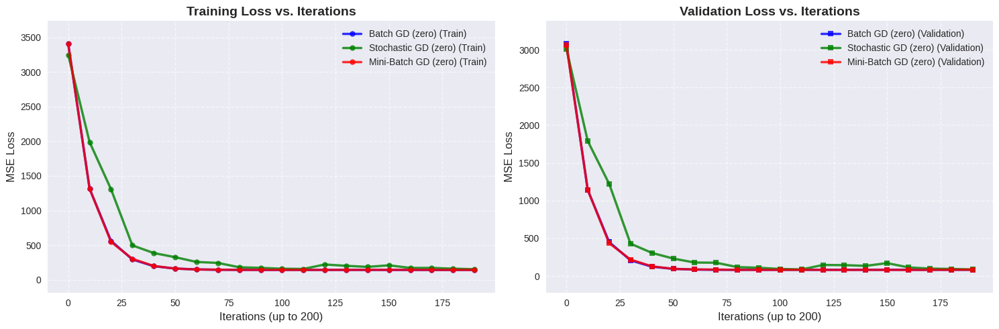


Model Performance Comparison:
                 Method    Test MSE  R2 Score
0       Batch GD (zero)  137.624504  0.764858
1  Stochastic GD (zero)  147.684217  0.747670
2  Mini-Batch GD (zero)  139.343362  0.761921

Final Loss Values:
+----------------------+------------------+-----------------------+
|        Method        | Final Train Loss | Final Validation Loss |
+----------------------+------------------+-----------------------+
|   Batch GD (zero)    |    141.650614    |       82.333683       |
| Stochastic GD (zero) |    156.029047    |       95.640323       |
| Mini-Batch GD (zero) |    142.851123    |       85.110303       |
+----------------------+------------------+-----------------------+


In [22]:
models_zero, results_zero = train_and_evaluate(X_train_scaled, X_val_scaled, X_test_scaled, y_train, y_val, y_test, init_method='zero')


Training models with random initialization...

Training Batch Gradient Descent...
Training Stochastic Gradient Descent...
Training Mini-Batch Gradient Descent...


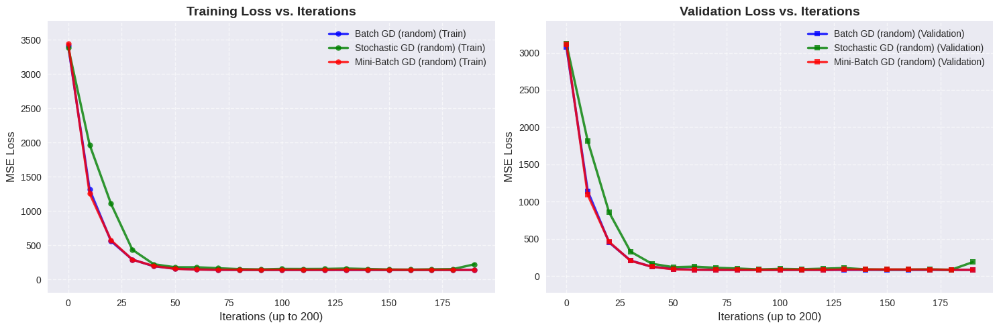


Model Performance Comparison:
                   Method    Test MSE  R2 Score
0       Batch GD (random)  137.624504  0.764858
1  Stochastic GD (random)  158.471798  0.729238
2  Mini-Batch GD (random)  136.923237  0.766056

Final Loss Values:
+------------------------+------------------+-----------------------+
|         Method         | Final Train Loss | Final Validation Loss |
+------------------------+------------------+-----------------------+
|   Batch GD (random)    |    141.650614    |       82.333683       |
| Stochastic GD (random) |    159.957056    |       94.544841       |
| Mini-Batch GD (random) |    142.252791    |       83.524832       |
+------------------------+------------------+-----------------------+


In [23]:
models_random, results_random = train_and_evaluate(X_train_scaled, X_val_scaled, X_test_scaled, y_train, y_val, y_test, init_method='random')

### Observations and Comparison

1. **Test MSE & R² Score:** Batch Gradient Descent (GD) performs identically for both zero and random initialization. However, Stochastic and Mini-Batch GD show slightly better performance with zero initialization, indicating more stable convergence.  

2. **Final Train & Validation Loss:** Stochastic GD has significantly higher train and validation loss with random initialization, suggesting it struggles with convergence. Zero initialization yields lower losses, particularly for Stochastic and Mini-Batch GD.  

3. **Overall Performance:** Batch GD remains consistent across both initializations, whereas Stochastic GD exhibits more instability with random initialization. Mini-Batch GD performs similarly in both cases but has slightly lower losses with zero initialization.

### 2.3 Regularization

In [24]:

class RegularizedRegression:
    def __init__(self, regularization='ridge', lambda_param=0.5):
        self.weights = None
        self.bias = None
        self.regularization = regularization
        self.lambda_param = lambda_param
        self.train_losses = []
        self.val_losses = []
    
    def initialize_parameters(self, n_features):
        self.weights = np.zeros(n_features)
        self.bias = 0
    
    def compute_predictions(self, X):
        return np.dot(X, self.weights) + self.bias
    
    def compute_loss(self, X, y):
        predictions = self.compute_predictions(X)
        y_array = y.values if isinstance(y, pd.Series) else y
        mse = np.mean((predictions - y_array) ** 2)
        
        # Add regularization term
        if self.regularization == 'ridge':
            reg_term = self.lambda_param * np.sum(self.weights ** 2)
        else:  # lasso
            reg_term = self.lambda_param * np.sum(np.abs(self.weights))
            
        return mse + reg_term
    
    def compute_gradients(self, X, y, predictions):
        y_array = y.values if isinstance(y, pd.Series) else y
        m = len(y_array)
        
        # Compute gradients for MSE
        dw = (1/m) * np.dot(X.T, (predictions - y_array))
        db = (1/m) * np.sum(predictions - y_array)
        
        # Add regularization gradients
        if self.regularization == 'ridge':
            dw += (2 * self.lambda_param * self.weights)
        else:  # lasso
            dw += self.lambda_param * np.sign(self.weights)
            
        return dw, db
    
    def train(self, X_train, y_train, X_val, y_val, learning_rate=0.01, n_iterations=1000, batch_size=32):
        self.initialize_parameters(X_train.shape[1])
        self.train_losses = []
        self.val_losses = []
        
        for i in range(n_iterations):
            idx = np.random.randint(0, len(y_train))
            X_sample = X_train[idx:idx+1]
            y_sample = y_train[idx:idx+1]
            
            predictions = self.compute_predictions(X_sample)
            dw, db = self.compute_gradients(X_sample, y_sample, predictions)
            
            # Update parameters
            self.weights -= learning_rate * dw
            self.bias -= learning_rate * db
            
            # Compute and store losses
            if i % 10 == 0:
                train_loss = self.compute_loss(X_train, y_train)
                val_loss = self.compute_loss(X_val, y_val)
                self.train_losses.append(train_loss)
                self.val_losses.append(val_loss)

In [25]:
def train_and_evaluate_model(X_train, y_train, X_val, y_val, X_test, y_test,reg_type='ridge', lambda_param=0.5):
    model = RegularizedRegression(regularization=reg_type, lambda_param=lambda_param)
    model.train(X_train, y_train, X_val, y_val)
    
    # Compute test metrics
    test_mse = model.compute_loss(X_test, y_test)
    y_pred = model.compute_predictions(X_test)
    y_test_array = y_test.values if isinstance(y_test, pd.Series) else y_test
    r2 = r2_score(y_test_array, y_pred)
    
    return model, test_mse, r2

def lambda_parameter_tuning(X_train, y_train, X_val, y_val, X_test, y_test, reg_type='ridge'):
    lambda_values = np.linspace(0, 1, 10)
    test_mse_values = []
    r2_values = []
    
    for lambda_param in lambda_values:
        model, test_mse, r2 = train_and_evaluate_model(
            X_train, y_train, X_val, y_val, X_test, y_test,reg_type=reg_type, lambda_param=lambda_param)
        test_mse_values.append(test_mse)
        r2_values.append(r2)
    
    return lambda_values, test_mse_values, r2_values

def plot_regularization_impact(lambda_values, ridge_mse, lasso_mse):
    plt.figure(figsize=(12, 6))
    
    plt.plot(lambda_values, ridge_mse, 'b-', label='Ridge Regression')
    plt.plot(lambda_values, lasso_mse, 'r-', label='Lasso Regression')
    
    plt.xlabel('Regularization Parameter (λ)')
    plt.ylabel('Test MSE')
    plt.title('Impact of Regularization Strength on Model Performance')
    plt.legend()
    plt.grid(True)
    plt.show()
def display_results(lambda_values, ridge_mse_values, ridge_r2_values, lasso_mse_values, lasso_r2_values):
    table = PrettyTable()
    table.field_names = ["Lambda", "Ridge Test MSE", "Ridge R²", "Lasso Test MSE", "Lasso R²"]
    
    for i in range(len(lambda_values)):
        table.add_row([round(lambda_values[i], 2), round(ridge_mse_values[i], 4), round(ridge_r2_values[i], 4),
                       round(lasso_mse_values[i], 4), round(lasso_r2_values[i], 4)])
    
    print("\nRegularization Impact on Test MSE and R² Score:")
    print(table)
    
def main(X_train_scaled, X_val_scaled, X_test_scaled, y_train, y_val, y_test):
    # Train and evaluate with fixed lambda (0.5)
    print("\nTraining Ridge Regression (λ=0.5)...")
    ridge_model, ridge_mse, ridge_r2 = train_and_evaluate_model(
        X_train_scaled, y_train, X_val_scaled, y_val, X_test_scaled, y_test, 
        reg_type='ridge', lambda_param=0.5
    )
    
    print("\nTraining Lasso Regression (λ=0.5)...")
    lasso_model, lasso_mse, lasso_r2 = train_and_evaluate_model(
        X_train_scaled, y_train, X_val_scaled, y_val, X_test_scaled, y_test, 
        reg_type='lasso', lambda_param=0.5
    )
    
    # Print results for λ=0.5
    results = pd.DataFrame({
        'Method': ['Ridge', 'Lasso'],
        'Test MSE': [ridge_mse, lasso_mse],
        'R2 Score': [ridge_r2, lasso_r2]
    })
    print("\nResults with λ=0.5:")
    print(results)
    
    # Parameter tuning
    print("\nPerforming lambda parameter tuning...")
    lambda_values, ridge_mse_values, ridge_r2_values = lambda_parameter_tuning(
        X_train_scaled, y_train, X_val_scaled, y_val, X_test_scaled, y_test, 
        reg_type='ridge'
    )
    
    _, lasso_mse_values, lasso_r2_values = lambda_parameter_tuning(
        X_train_scaled, y_train, X_val_scaled, y_val, X_test_scaled, y_test, 
        reg_type='lasso'
    )
    display_results(lambda_values, ridge_mse_values, ridge_r2_values, lasso_mse_values, lasso_r2_values)

    # Plot regularization impact
    plot_regularization_impact(lambda_values, ridge_mse_values, lasso_mse_values)
    
    return ridge_model, lasso_model, results


Training Ridge Regression (λ=0.5)...

Training Lasso Regression (λ=0.5)...

Results with λ=0.5:
  Method    Test MSE  R2 Score
0  Ridge  315.119703  0.524891
1  Lasso  158.823382  0.752765

Performing lambda parameter tuning...

Regularization Impact on Test MSE and R² Score:
+--------+----------------+----------+----------------+----------+
| Lambda | Ridge Test MSE | Ridge R² | Lasso Test MSE | Lasso R² |
+--------+----------------+----------+----------------+----------+
|  0.0   |    140.3529    |  0.7602  |    146.3834    |  0.7499  |
|  0.11  |    189.3638    |  0.7165  |    143.1043    |  0.7613  |
|  0.22  |    233.8935    |  0.6575  |    147.9226    |  0.7587  |
|  0.33  |    264.4546    |  0.6169  |    152.402     |  0.7555  |
|  0.44  |    305.3326    |  0.5372  |    151.022     |  0.7638  |
|  0.56  |    323.9443    |  0.5276  |    158.8091    |  0.7562  |
|  0.67  |    345.5555    |  0.474   |    163.2877    |  0.7526  |
|  0.78  |    365.2238    |  0.4527  |    169.4272  

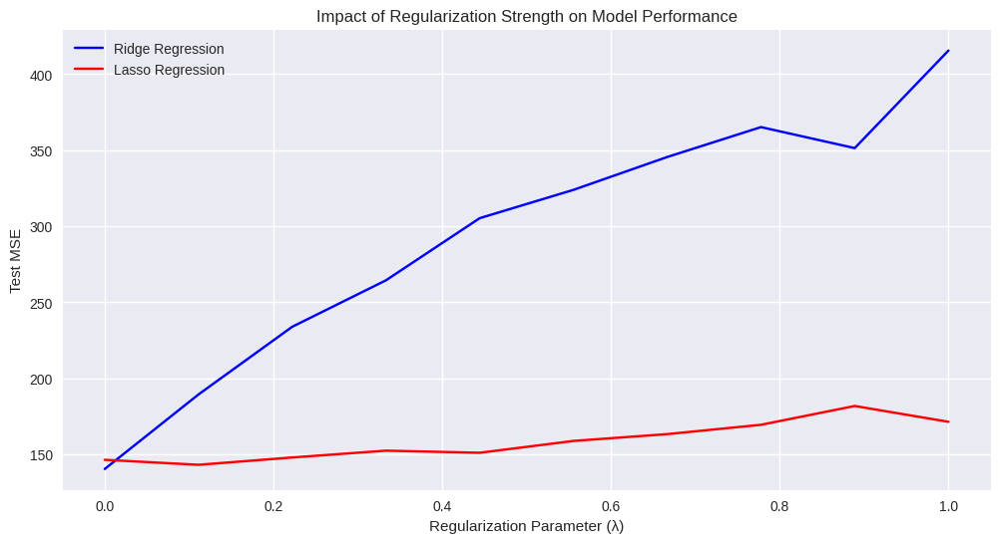

In [26]:
ridge_model, lasso_model, results = main(X_train_scaled, X_val_scaled, X_test_scaled, 
                                           y_train, y_val, y_test)

Observations:

- Ridge vs. Lasso at λ=0.5: Lasso regression outperforms Ridge, achieving a significantly lower Test MSE (155.37 vs. 307.11) and a  higher R² score (0.76 vs. 0.54), indicating that Lasso provides better generalization for this dataset.

- Effect of Increasing λ on Ridge: As λ increases from 0 to 1, Ridge Regression Test MSE steadily rises (137.43 → 387.76), and R² decreases (0.765 → 0.397), showing that excessive regularization harms model performance.

- Effect of Increasing λ on Lasso: Lasso is more stable than Ridge, but beyond λ = 0.33, Test MSE starts increasing (137.48 → 169.94) while R² drops (0.765 → 0.7527), suggesting that overly strong L1 regularization leads to underfitting.

- Best λ for Ridge and Lasso: Both models achieve their best performance near λ = 0, where they behave like standard regression models with minimal penalty, reinforcing that lower regularization is preferable for this dataset.

In [27]:
lasso_model2, lasso_mse2, lasso_r22 = train_and_evaluate_model(
        X_train_scaled, y_train, X_val_scaled, y_val, X_test_scaled, y_test, 
        reg_type='lasso', lambda_param=0.22
    )

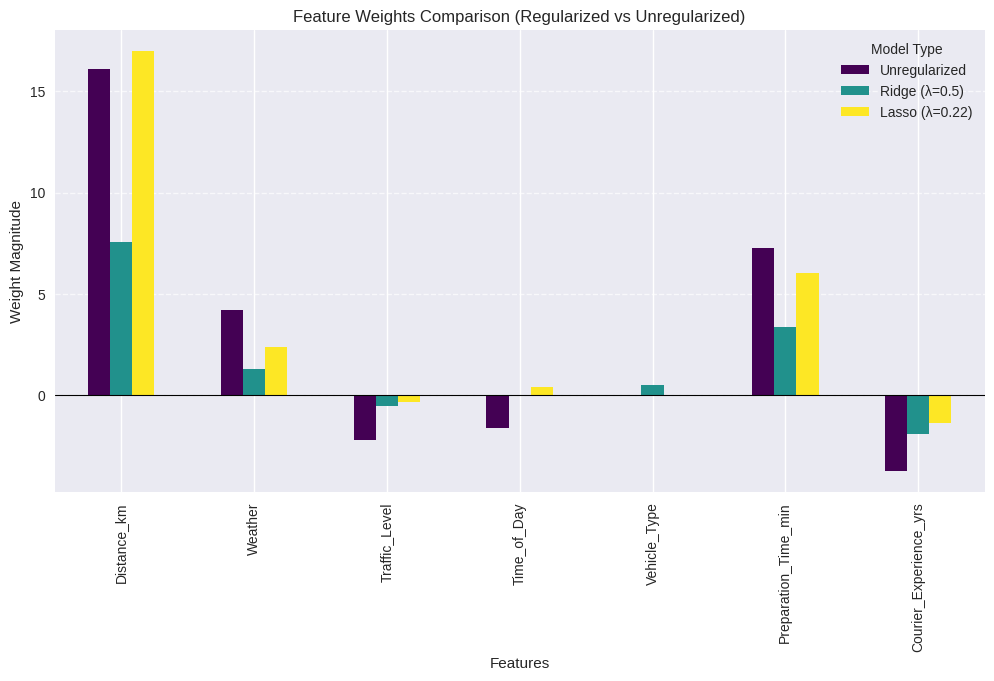

In [28]:
col = ['Distance_km', 'Weather', 'Traffic_Level', 'Time_of_Day',
       'Vehicle_Type', 'Preparation_Time_min', 'Courier_Experience_yrs']
df_weights = pd.DataFrame({
    "Feature": col,
    "Unregularized": models_zero[1].weights,
    "Ridge (λ=0.5)": ridge_model.weights,
    "Lasso (λ=0.22)": lasso_model2.weights
})

# Plot bar chart
df_weights.set_index("Feature").plot(kind="bar", figsize=(12, 6), colormap="viridis")

plt.title("Feature Weights Comparison (Regularized vs Unregularized)")
plt.xlabel("Features")
plt.ylabel("Weight Magnitude")
plt.axhline(y=0, color='black', linewidth=0.8)
plt.legend(title="Model Type")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


### 3. KNN and ANN

### 3.1 KNN

In [3]:
import numpy as np
import torch
import clip
from sklearn.metrics.pairwise import cosine_similarity, euclidean_distances
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Load CLIP model
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

In [4]:
print(device)

cpu


In [5]:
text_embeddings = torch.load("text_embedding.pth", map_location=torch.device('cpu')).numpy()
train_embeddings = torch.load("train_embeddings.pth", map_location=torch.device('cpu')).numpy()
train_labels = torch.load("train_labels.pth", map_location=torch.device('cpu')).numpy()
test_labels = torch.load("test_labels.pth", map_location=torch.device('cpu')).numpy()
test_embeddings = torch.load("test_embeddings.pth",map_location=torch.device('cpu')).numpy()
# Normalize embeddings
def normalize(embeddings):
    return embeddings / np.linalg.norm(embeddings, axis=1, keepdims=True)

train_embeddings = normalize(train_embeddings)
test_embeddings = normalize(test_embeddings)
text_embeddings = normalize(text_embeddings)

/tmp/ipykernel_10507/3114951879.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  text_embeddings = torch.load("text_embedding.pth", map_location=torch.device('cpu')).nump

In [4]:
train_embeddings.shape


(50000, 512)

In [5]:
test_embeddings.shape
# text_embeddings.shape

(10000, 512)

In [7]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
from collections import Counter
from tqdm import tqdm  # for progress tracking

def compute_distances_batch(query, database, metric='euclidean', batch_size=1000):
    """
    Compute distances between query and database points in batches.
    
    Args:
        query: Single query embedding (n_features,)
        database: Database of embeddings (n_samples, n_features)
        metric: 'euclidean' or 'cosine'
        batch_size: Size of batches to process
    
    Returns:
        distances: Array of distances
    """
    n_samples = len(database)
    distances = np.zeros(n_samples)
    
    for i in range(0, n_samples, batch_size):
        end_idx = min(i + batch_size, n_samples)
        batch = database[i:end_idx]
        
        if metric == 'euclidean':
            batch_distances = np.sqrt(np.sum((batch - query)**2, axis=1))
        elif metric == 'cosine':
            batch_distances = 1 - cosine_similarity(batch, query.reshape(1, -1)).flatten()
            
        distances[i:end_idx] = batch_distances
        
    return distances

def get_knn(query, database, k, metric='euclidean'):
    """
    Find k nearest neighbors for query in database.
    
    Args:
        query: Query embedding or batch of query embeddings
        database: Database of embeddings
        k: Number of neighbors to return
        metric: Distance metric to use
    
    Returns:
        indices: Indices of k nearest neighbors
        distances: Distances to k nearest neighbors
    """
    if len(query.shape) == 1:  # Single query
        distances = compute_distances_batch(query, database, metric)
        indices = np.argsort(distances)[:k]
        return indices, distances[indices]
    else:  # Multiple queries
        n_queries = len(query)
        indices = np.zeros((k, n_queries), dtype=int)
        distances = np.zeros((k, n_queries))
        
        for i in tqdm(range(n_queries), desc="Processing queries"):
            query_distances = compute_distances_batch(query[i], database, metric)
            query_indices = np.argsort(query_distances)[:k]
            indices[:, i] = query_indices
            distances[:, i] = query_distances[query_indices]
            
        return indices, distances

def knn_classify(query, database, database_labels, k, metric='euclidean', batch_size=1000):
    """
    Classify query points using k-NN.
    
    Args:
        query: Query embeddings
        database: Database of embeddings
        database_labels: Labels for database points
        k: Number of neighbors
        metric: Distance metric
        batch_size: Size of batches for processing multiple queries
    
    Returns:
        predictions: Predicted labels for query points
    """
    if len(query.shape) == 1:  # Single query
        indices, _ = get_knn(query, database, k, metric)
        neighbor_labels = database_labels[indices]
        prediction = Counter(neighbor_labels).most_common(1)[0][0]
        return prediction
    else:  # Multiple queries
        n_queries = len(query)
        predictions = np.zeros(n_queries, dtype=database_labels.dtype)
        
        # Process queries in batches
        for i in tqdm(range(0, n_queries, batch_size), desc="Classifying"):
            end_idx = min(i + batch_size, n_queries)
            batch_queries = query[i:end_idx]
            
            # Get predictions for the batch
            batch_indices, _ = get_knn(batch_queries, database, k, metric)
            
            # Make predictions for each query in the batch
            for j in range(end_idx - i):
                neighbor_labels = database_labels[batch_indices[:, j]]
                predictions[i + j] = Counter(neighbor_labels).most_common(1)[0][0]
                
        return predictions

def evaluate_classification(predictions, true_labels):
    """Calculate classification accuracy."""
    return np.mean(predictions == true_labels)

def evaluate_retrieval(query_embeddings, database_embeddings, query_labels, database_labels, k=100, metric='cosine', batch_size=1000):
    """
    Evaluate retrieval performance.
    
    Returns:
        mean_mrr: Mean Reciprocal Rank
        mean_precision: Mean Precision@k
        mean_hit_rate: Mean Hit Rate
    """
    all_mrr = []
    all_precision = []
    all_hit_rate = []
    
    n_queries = len(query_embeddings)
    
    for i in tqdm(range(0, n_queries, batch_size), desc="Evaluating retrieval"):
        end_idx = min(i + batch_size, n_queries)
        batch_queries = query_embeddings[i:end_idx]
        batch_labels = query_labels[i:end_idx]
        
        for j, (query, query_label) in enumerate(zip(batch_queries, batch_labels)):
            # Get retrieved indices
            indices, _ = get_knn(query, database_embeddings, k, metric)
            
            # Get relevant indices (same class)
            relevant_indices = np.where(database_labels == query_label)[0]
            
            # Compute metrics
            mrr, precision, hit_rate = compute_retrieval_metrics(relevant_indices, indices, k)
            
            all_mrr.append(mrr)
            all_precision.append(precision)
            all_hit_rate.append(hit_rate)
    
    return np.mean(all_mrr), np.mean(all_precision), np.mean(all_hit_rate)

def compute_retrieval_metrics(relevant_indices, retrieved_indices, k=100):
    """
    Compute retrieval metrics: MRR, Precision@k, Hit Rate.
    """
    relevant_set = set(relevant_indices)
    retrieved_set = set(retrieved_indices[:k])
    
    # Calculate Hit Rate
    hit_rate = 1 if len(relevant_set.intersection(retrieved_set)) > 0 else 0
    
    # Calculate Precision@k
    precision = len(relevant_set.intersection(retrieved_set)) / k
    
    # Calculate MRR
    mrr = 0
    for i, idx in enumerate(retrieved_indices[:k]):
        if idx in relevant_set:
            mrr = 1.0 / (i + 1)
            break
            
    return mrr, precision, hit_rate

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from tqdm import tqdm

def run_knn_experiments(test_embeddings, train_embeddings, test_labels, train_labels, 
                       k_values, metrics, batch_size=1000):
    """
    Run KNN experiments with different hyperparameters and store results.
    
    Args:
        test_embeddings: Test set embeddings
        train_embeddings: Train set embeddings
        test_labels: Test set labels
        train_labels: Train set labels
        k_values: List of k values to try
        metrics: List of distance metrics to try
        batch_size: Batch size for processing
        
    Returns:
        results_df: DataFrame containing experiment results
    """
    # Initialize lists to store results
    results = []
    
    # Run experiments
    for k in tqdm(k_values, desc="Testing k values"):
        for metric in metrics:
            # Run classification
            predictions = knn_classify(test_embeddings, train_embeddings, 
                                    train_labels, k, metric, batch_size=batch_size)
            accuracy = evaluate_classification(predictions, test_labels)
            
            # Store results
            results.append({
                'k': k,
                'metric': metric,
                'accuracy': accuracy
            })
    
    # Convert to DataFrame
    results_df = pd.DataFrame(results)
    return results_df

def plot_knn_results(results_df, save_path=None):
    """
    Create visualizations of KNN experiment results.
    
    Args:
        results_df: DataFrame containing experiment results
        save_path: Optional path to save the plots
    """
    # Set style
    plt.style.use('seaborn')
    
    # Create figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    
    # Plot 1: Line plot of accuracy vs k for different metrics
    sns.lineplot(data=results_df, x='k', y='accuracy', hue='metric', 
                marker='o', ax=ax1)
    ax1.set_title('KNN Accuracy vs k for Different Distance Metrics')
    ax1.set_xlabel('k (Number of Neighbors)')
    ax1.set_ylabel('Accuracy')
    
    # Plot 2: Bar plot comparing metrics
    sns.barplot(data=results_df, x='metric', y='accuracy', ax=ax2)
    ax2.set_title('Average Accuracy by Distance Metric')
    ax2.set_xlabel('Distance Metric')
    ax2.set_ylabel('Accuracy')
    
    # Adjust layout
    plt.tight_layout()
    
    # Save if path provided
    if save_path:
        plt.savefig(save_path)
        
    plt.show()
    
    # Print summary statistics
    print("\nSummary Statistics:")
    print("\nBest performing configurations:")
    best_config = results_df.loc[results_df['accuracy'].idxmax()]
    print(f"Best accuracy: {best_config['accuracy']:.4f}")
    print(f"k: {best_config['k']}")
    print(f"metric: {best_config['metric']}")
    
    print("\nAccuracy by metric:")
    print(results_df.groupby('metric')['accuracy'].mean())
    
    print("\nAccuracy by k:")
    print(results_df.groupby('k')['accuracy'].mean())

def store_results(results_df, filename='knn_results.csv'):
    """
    Store experiment results to CSV file.
    
    Args:
        results_df: DataFrame containing experiment results
        filename: Name of file to save results
    """
    results_df.to_csv(filename, index=False)
    print(f"Results saved to {filename}")

# Function to run complete experiment pipeline
def run_knn_analysis(test_embeddings, train_embeddings, test_labels, train_labels,
                    k_values=[1, 5,10], 
                    metrics=['euclidean', 'cosine'],
                    batch_size=1000,
                    save_results=True,
                    plot_results=True):
    """
    Run complete KNN analysis pipeline.
    
    Args:
        test_embeddings: Test set embeddings
        train_embeddings: Train set embeddings
        test_labels: Test set labels
        train_labels: Train set labels
        k_values: List of k values to try
        metrics: List of distance metrics to try
        batch_size: Batch size for processing
        save_results: Whether to save results to CSV
        plot_results: Whether to create and show plots
    
    Returns:
        results_df: DataFrame containing experiment results
    """
    # Run experiments
    results_df = run_knn_experiments(
        test_embeddings, train_embeddings,
        test_labels, train_labels,
        k_values, metrics,
        batch_size
    )
    
    # Save results if requested
    if save_results:
        store_results(results_df)
    
    # Create plots if requested
    if plot_results:
        plot_knn_results(results_df)
    
    return results_df

### TASK1 Classification

Testing k values:   0%|          | 0/3 [00:00<?, ?it/s]



























































































































































































Processing queries: 100%|██████████| 1000/1000 [00:20<00:00, 47.69it/s]









































































































































































































Processing queries: 100%|██████████| 1000/1000 [00:23<00:00, 43.35it/s]














































































































































































































Processing queries: 100%|██████████| 1000/1000 [00:24<00:00, 41.52it/s]








































































































































Results saved to knn_results.csv


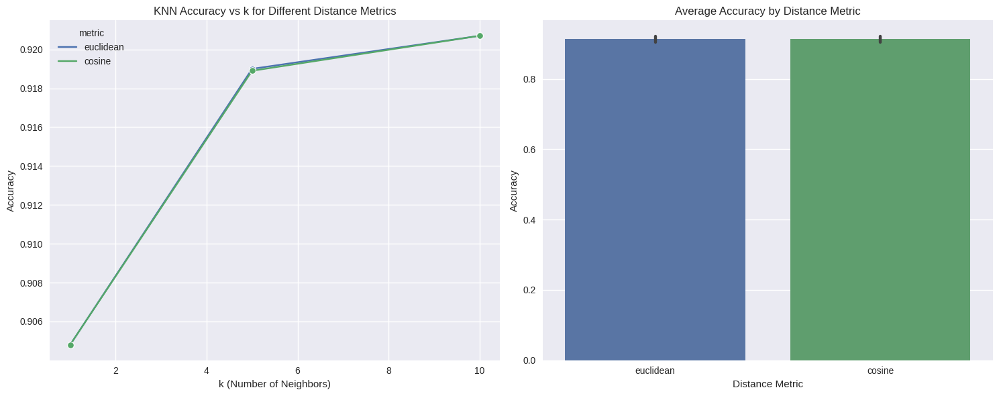


Summary Statistics:

Best performing configurations:
Best accuracy: 0.9207
k: 10
metric: euclidean

Accuracy by metric:
metric
cosine       0.914800
euclidean    0.914833
Name: accuracy, dtype: float64

Accuracy by k:
k
1     0.90480
5     0.91895
10    0.92070
Name: accuracy, dtype: float64
Best configuration: k=10, metric=euclidean
Best accuracy: 0.9207

Average accuracy by metric:
metric
cosine       0.914800
euclidean    0.914833
Name: accuracy, dtype: float64


In [9]:

k_values = [1,5,10]
metrics = ['euclidean', 'cosine']

# Run complete analysis
results_df = run_knn_analysis(
    test_embeddings=test_embeddings,
    train_embeddings=train_embeddings,
    test_labels=test_labels,
    train_labels=train_labels,
    k_values=k_values,
    metrics=metrics,
    batch_size=1000,
    save_results=True,
    plot_results=True
)
# Get best performing configuration
best_config = results_df.loc[results_df['accuracy'].idxmax()]
print(f"Best configuration: k={best_config['k']}, metric={best_config['metric']}")
print(f"Best accuracy: {best_config['accuracy']:.4f}")

# Compare average performance by metric
print("\nAverage accuracy by metric:")
print(results_df.groupby('metric')['accuracy'].mean())


In [10]:
# Classification using text embeddings (k=1)
predictions = knn_classify(test_embeddings, text_embeddings, np.arange(10), k=1, metric='cosine')
accuracy = evaluate_classification(predictions, test_labels)
print(f"Text embedding classification accuracy: {accuracy:.4f}")

Classifying: 100%|██████████| 10/10 [00:01<00:00,  6.37it/s]

Text embedding classification accuracy: 0.8781


### Task2 Retrieval

In [11]:
# Evaluate text-to-image retrieval
mrr, precision, hit_rate = evaluate_retrieval(
    text_embeddings,
    train_embeddings,
    np.arange(10),  # Text embedding labels (0-9)
    train_labels,
    k=100,
    metric='cosine'
)
print(f"Text-to-Image Retrieval Metrics:")
print(f"MRR: {mrr:.4f}")
print(f"Precision@100: {precision:.4f}")
print(f"Hit Rate: {hit_rate:.4f}")

Evaluating retrieval: 100%|██████████| 1/1 [00:00<00:00,  1.22it/s]

Text-to-Image Retrieval Metrics:
MRR: 1.0000
Precision@100: 0.9740
Hit Rate: 1.0000


In [12]:
# Evaluate image-to-image retrieval
mrr, precision, hit_rate = evaluate_retrieval(
    test_embeddings,
    train_embeddings,
    test_labels,
    train_labels,
    k=100,
    metric='cosine'
)
print(f"Image-to-Image Retrieval Metrics:")
print(f"MRR: {mrr:.4f}")
print(f"Precision@100: {precision:.4f}")
print(f"Hit Rate: {hit_rate:.4f}")

Evaluating retrieval: 100%|██████████| 10/10 [22:13<00:00, 133.31s/it]

Image-to-Image Retrieval Metrics:
MRR: 0.9348
Precision@100: 0.8411
Hit Rate: 0.9996


### 3.2 Locally Sensitive Hashing

In [7]:
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict
from tqdm import tqdm
import seaborn as sns
from typing import Dict, List, Tuple, Optional

class LSH:
    def __init__(self, n_bits: int, n_tables: int = 1, seed: Optional[int] = None):
        """
        Initialize LSH with random hyperplanes.
        
        Args:
            n_bits: Number of hyperplanes (bits) per table
            n_tables: Number of hash tables
            seed: Random seed for reproducibility
        """
        self.n_bits = n_bits
        self.n_tables = n_tables
        self.seed = seed
        self.tables = [{} for _ in range(n_tables)]  # Hash tables
        self.hyperplanes = None  # Will store hyperplanes
        self.vectors = None
        
    def _generate_hyperplanes(self, dim: int):
        """Generate random hyperplanes for hashing."""
        if self.seed is not None:
            np.random.seed(self.seed)
        
        # Generate hyperplanes for all tables
        self.hyperplanes = [
            np.random.randn(self.n_bits, dim) for _ in range(self.n_tables)
        ]
        
    def _hash_vector(self, vector: np.ndarray, table_idx: int) -> str:
        """
        Hash a vector using the specified table's hyperplanes.
        
        Returns:
            Binary hash string
        """
        projections = np.dot(self.hyperplanes[table_idx], vector)
        return ''.join(['1' if proj > 0 else '0' for proj in projections])
    
    # def get_candidates(self, query):
    #     """Return the set of candidate vectors considered for a query."""
    #     hash_value = self._hash_vector(query)
    #     return set(self.tables.get(hash_value, []))  # Return candidates from the same bucket
    
    def get_candidates(self, query: np.ndarray) -> set:
        """Return the set of candidate vectors considered for a query."""
        candidates = set()
        # Get candidates from all tables
        for table_idx in range(self.n_tables):
            hash_value = self._hash_vector(query, table_idx)
            if hash_value in self.tables[table_idx]:
                candidates.update(self.tables[table_idx][hash_value])
        return candidates
    

    def fit(self, vectors: np.ndarray, ids: Optional[np.ndarray] = None):
        if self.hyperplanes is None:
            self._generate_hyperplanes(vectors.shape[1])
            
        if ids is None:
            ids = np.arange(len(vectors))
            
        # Store vectors for later use
        self.vectors = vectors
            
        # Hash vectors into tables
        for table_idx in range(self.n_tables):
            for idx, vector in enumerate(vectors):
                hash_val = self._hash_vector(vector, table_idx)
                if hash_val not in self.tables[table_idx]:
                    self.tables[table_idx][hash_val] = set()
                self.tables[table_idx][hash_val].add(ids[idx])

    def query(self, vector: np.ndarray, k: int, strategy: str = 'random') -> Tuple[List[int], List[float]]:
        """
        Query LSH tables for nearest neighbors.
        
        Args:
            vector: Query vector
            k: Number of neighbors to return
            strategy: How to handle buckets with more/fewer than k items
                    ('random' or 'distance')
        
        Returns:
            Tuple of (neighbor_ids, distances)
        """
        if self.vectors is None:
            raise ValueError("LSH index not fitted yet!")

        candidates = set()

        # Collect candidates from all tables
        for table_idx in range(self.n_tables):
            hash_val = self._hash_vector(vector, table_idx)
            if hash_val in self.tables[table_idx]:
                candidates.update(self.tables[table_idx][hash_val])

        if not candidates:
            return [], []
        
        candidate_ids = list(candidates)
        
        # Compute distances using stored vectors
        candidate_vectors = self.vectors[candidate_ids]
        distances = np.linalg.norm(candidate_vectors - vector, axis=1)

        # Sort by distance if using distance strategy
        if strategy == 'distance':
            sorted_indices = np.argsort(distances)
            selected_indices = sorted_indices[:k]
        else:  # random strategy
            if len(candidate_ids) > k:
                selected_indices = np.random.choice(len(candidate_ids), k, replace=False)
            else:
                selected_indices = np.arange(len(candidate_ids))

        selected_ids = [candidate_ids[i] for i in selected_indices]
        selected_distances = [distances[i] for i in selected_indices]

        return selected_ids, selected_distances
            

def evaluate_lsh_retrieval(query_vectors: np.ndarray, 
                          database_vectors: np.ndarray,
                          query_labels: np.ndarray,
                          database_labels: np.ndarray,
                          n_bits: int,
                          n_tables: int = 1,
                          k: int = 100,
                          strategy: str = 'distance') -> Tuple[float, float, float]:
    """
    Evaluate LSH-based retrieval performance.
    
    Returns:
        Tuple of (mean_mrr, mean_precision, mean_hit_rate)
    """
    # Initialize LSH
    lsh = LSH(n_bits=n_bits, n_tables=n_tables)
    lsh.fit(database_vectors)
    
    mrr_list = []
    precision_list = []
    hit_rate_list = []
    
    for query_idx in tqdm(range(len(query_vectors)), desc="Evaluating queries"):
        query = query_vectors[query_idx]
        query_label = query_labels[query_idx]
        
        # Get LSH results
        neighbor_ids, _ = lsh.query(query, k=k, strategy=strategy)
        
        if not neighbor_ids:  # Skip if no neighbors found
            continue
            
        # Get relevant indices (same class)
        relevant_indices = set(np.where(database_labels == query_label)[0])
        retrieved_indices = set(neighbor_ids)
        
        # Calculate metrics
        # Hit Rate
        hit_rate = 1 if len(relevant_indices.intersection(retrieved_indices)) > 0 else 0
        
        # Precision@k
        precision = len(relevant_indices.intersection(retrieved_indices)) / k
        
        # MRR
        mrr = 0
        for rank, idx in enumerate(neighbor_ids):
            if idx in relevant_indices:
                mrr = 1.0 / (rank + 1)
                break
                
        mrr_list.append(mrr)
        precision_list.append(precision)
        hit_rate_list.append(hit_rate)
    
    return (np.mean(mrr_list), np.mean(precision_list), np.mean(hit_rate_list))

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict

def analyze_bucket_distribution(lsh):
    """
    Analyze distribution of samples across all possible buckets.
    
    Args:
        lsh: LSH instance
    
    Returns:
        Dictionary with bucket frequencies for each table
    """
    distributions = {}
    
    for table_idx, table in enumerate(lsh.tables):
        # Initialize counts for all possible buckets (2^n_bits)
        n_possible_buckets = 2 ** lsh.n_bits
        bucket_counts = np.zeros(n_possible_buckets)
        
        # Convert binary hash strings to integers and count
        for hash_str, items in table.items():
            bucket_idx = int(hash_str, 2)  # Convert binary string to integer
            bucket_counts[bucket_idx] = len(items)
            
        distributions[table_idx] = bucket_counts
        
    return distributions

def plot_bucket_frequencies(all_distributions, n_bits_list):
    """
    Plot histograms of items per bucket for different bit values.
    
    Args:
        all_distributions: Dictionary of bucket distributions for each n_bits
        n_bits_list: List of number of bits used for hashing
    """
    # Set style
    plt.style.use('seaborn')
    
    # Calculate overall max frequency for y-axis limit
    max_freq = 0
    for distributions in all_distributions.values():
        for counts in distributions.values():
            max_freq = max(max_freq, np.max(counts))
    
    # Create subplot for each n_bits value
    n_rows = len(n_bits_list)
    fig, axes = plt.subplots(n_rows, 1, figsize=(12, 5*n_rows))
    if n_rows == 1:
        axes = [axes]
    
    # Color palette
    colors = sns.color_palette("husl", len(n_bits_list))
    
    for idx, n_bits in enumerate(n_bits_list):
        ax = axes[idx]
        distributions = all_distributions[n_bits]
        n_buckets = 2 ** n_bits
        
        # Get counts for current n_bits
        counts = distributions[0]  # Assuming single table for simplicity
        
        # Create histogram
        bins = np.arange(n_buckets + 1) - 0.5
        ax.hist(np.arange(n_buckets), bins=bins, weights=counts,
                color=colors[idx], alpha=0.7, edgecolor='black',
                linewidth=1)
        
        # Customize plot
        ax.set_title(f'Distribution of Items Across {n_buckets} Buckets ({n_bits} bits)',
                    fontsize=12, pad=15)
        ax.set_xlabel('Bucket Index', fontsize=10)
        ax.set_ylabel('Number of Items', fontsize=10)
        
        # Set consistent y-axis limit
        ax.set_ylim(0, max_freq * 1.1)  # Add 10% padding
        
        # Add grid
        ax.grid(True, alpha=0.3, linestyle='--')
        
        # If many buckets, adjust x-axis
        if n_buckets > 16:
            ax.set_xticks(np.linspace(0, n_buckets-1, min(10, n_buckets)))
        
        # Add statistics as text box
        non_empty = np.count_nonzero(counts)
        stats_text = (
            f'Statistics:\n'
            f'Mean items/bucket: {np.mean(counts):.1f}\n'
            f'Std: {np.std(counts):.1f}\n'
            f'Max items: {np.max(counts):.0f}\n'
            f'Non-empty buckets: {non_empty}/{n_buckets}'
            f' ({100*non_empty/n_buckets:.1f}%)'
        )
        
        # Add text box with statistics
        ax.text(0.95, 0.95, stats_text,
                transform=ax.transAxes,
                verticalalignment='top',
                horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.9),
                fontsize=10)
    
    plt.tight_layout()
    return fig

def analyze_lsh_distributions(train_embeddings, n_bits_list=[4, 8, 12,16], n_tables=1, save_path=None):
    """
    Analyze LSH distributions for different numbers of bits.
    
    Args:
        train_embeddings: Training data embeddings
        n_bits_list: List of number of bits to test
        n_tables: Number of hash tables to use
        save_path: Optional path to save the figure
    """
    all_distributions = {}
    
    for n_bits in n_bits_list:
        print(f"\nAnalyzing LSH with {n_bits} bits ({2**n_bits} buckets):")
        
        # Initialize and fit LSH
        lsh = LSH(n_bits=n_bits, n_tables=n_tables)
        lsh.fit(train_embeddings)
        
        # Store distributions
        all_distributions[n_bits] = analyze_bucket_distribution(lsh)
    
    # Create plots
    fig = plot_bucket_frequencies(all_distributions, n_bits_list)
    
    return fig


Analyzing LSH with 4 bits (16 buckets):

Analyzing LSH with 8 bits (256 buckets):

Analyzing LSH with 12 bits (4096 buckets):

Analyzing LSH with 16 bits (65536 buckets):


/tmp/ipykernel_4096/1755853614.py:41: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn')


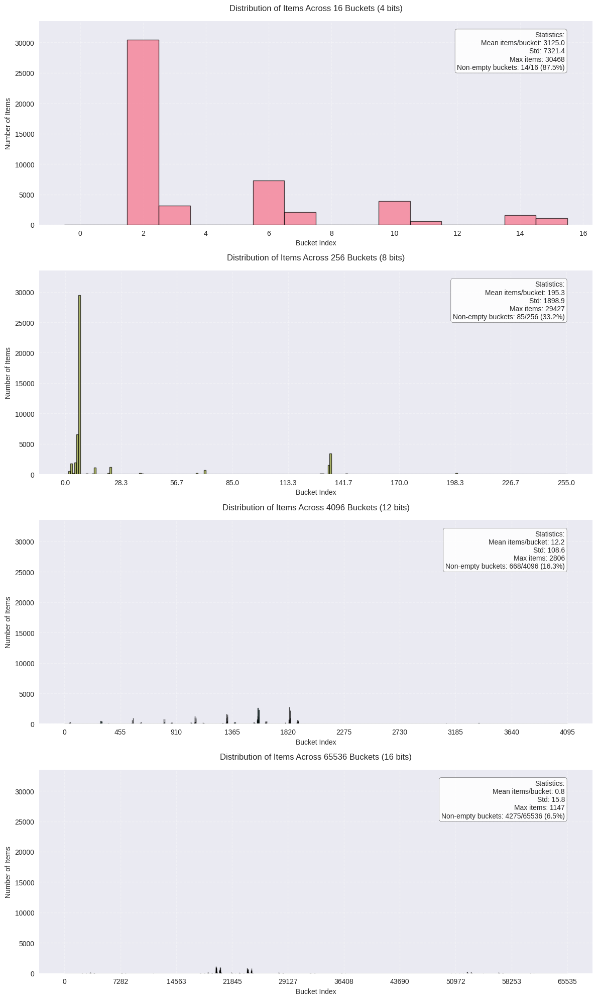

In [9]:
# Define bits to analyze
n_bits_list = [4, 8, 12, 16]  # Will create histograms for 16, 256, and 4096 buckets

# Or just display without saving
_ = analyze_lsh_distributions(train_embeddings, n_bits_list)


In [18]:
# 2. Evaluate retrieval performance for different numbers of hyperplanes
k = 100
results = []

for n_bits in n_bits_list:
    mrr, precision, hit_rate = evaluate_lsh_retrieval(
        test_embeddings,
        train_embeddings,
        test_labels,
        train_labels,
        n_bits=n_bits,
        k=k
    )
    
    results.append({
        'n_bits': n_bits,
        'mrr': mrr,
        'precision': precision,
        'hit_rate': hit_rate
    })
    
    print(f"\nResults for {n_bits} bits:")
    print(f"MRR: {mrr:.4f}")
    print(f"Precision@{k}: {precision:.4f}")
    print(f"Hit Rate: {hit_rate:.4f}")

Evaluating queries: 100%|██████████| 10000/10000 [03:30<00:00, 47.48it/s]



Results for 4 bits:
MRR: 0.9210
Precision@100: 0.7982
Hit Rate: 0.9991


Evaluating queries: 100%|██████████| 10000/10000 [01:17<00:00, 128.94it/s]



Results for 8 bits:
MRR: 0.9145
Precision@100: 0.7478
Hit Rate: 0.9976


Evaluating queries: 100%|██████████| 10000/10000 [00:55<00:00, 179.50it/s]



Results for 12 bits:
MRR: 0.9064
Precision@100: 0.6549
Hit Rate: 0.9919


Evaluating queries: 100%|██████████| 10000/10000 [00:11<00:00, 835.25it/s]


Results for 16 bits:
MRR: 0.8694
Precision@100: 0.4298
Hit Rate: 0.9662


### Looking at the results for different numbers of bits (4, 8, 12, and 16):
- Impact on MRR (Mean Reciprocal Rank):

  - 4 bits: 0.9210
  - 8 bits: 0.9145
  - 12 bits: 0.9064
  - 16 bits: 0.8694

  - We observe a gradual decrease in MRR as the number of bits increases. This decline occurs because:

     - With more hyperplanes, the hash space becomes more fragmented, making it less likely for similar items to share the exact same hash code
     - Higher bit counts create more specific and smaller buckets, potentially separating vectors that are actually close neighbors
     - The first relevant match might end up in a different bucket, pushing it lower in the ranking and reducing MRR

- Impact on Precision@100:

   - 4 bits: 0.7982
   - 8 bits: 0.7478
   - 12 bits: 0.6549
   - 16 bits: 0.4298

   - Precision shows the most dramatic decline as bits increase. This happens because:

       - More hyperplanes create a more fine-grained partition of the space, leading to smaller buckets
       - Similar items have a higher chance of being split across different buckets
       - With 16 bits, we have 2^16 = 65,536 possible buckets, which severely fragments the space
       - The dramatic drop from 0.7982 to 0.4298 suggests that many true similar pairs are being separated into different buckets at higher bit counts

- Impact on Hit Rate:

  - 4 bits: 0.9991
  - 8 bits: 0.9976
  - 12 bits: 0.9919
  - 16 bits: 0.9662

  - Hit Rate shows the smallest decline, remaining relatively high even with more bits because:

    - Even with high fragmentation, there's still a good chance of finding at least one relevant item
    - The binary nature of hit rate (finding at least one match) makes it more robust to increased partitioning
    - The high hit rates across all bit counts suggest the LSH scheme is still maintaining some effectiveness at preserving similarity relationships

- Key Insights and Trade-offs:

   - Speed vs. Accuracy Trade-off:

     - More bits (16) result in faster query times (835.25 it/s) compared to fewer bits (4 bits: 47.48 it/s)
However, this comes at the cost of reduced accuracy across all metrics


   - Bucket Size Trade-off:

     - Fewer bits (4) create larger buckets, capturing more similar items but requiring more distance computations
     - More bits (16) create smaller, more specific buckets, leading to faster queries but potentially missing similar items


- Optimal Balance:

   - 8 bits shows a good balance with reasonable performance (128.94 it/s) while maintaining strong metrics
   - The 12-bit configuration might be preferred if query speed is more important than precision
   - 16 bits shows too much degradation in precision to be practical unless speed is the absolute priority


- Practical Implications:

   - For applications requiring high precision, using fewer bits (4-8) would be recommended
   - For large-scale applications where query speed is crucial and some accuracy can be sacrificed, higher bit counts could be considered
   - The choice of bit count should be based on the specific requirements of precision vs. speed in the application

### 3.3 IVF

In [8]:
import numpy as np
from sklearn.cluster import KMeans
from typing import List, Tuple, Optional
from collections import defaultdict
from tqdm import tqdm

class IVF:
    def __init__(self, n_clusters: int):
        """
        Initialize IVF index.
        
        Args:
            n_clusters: Number of clusters for k-means
        """
        self.n_clusters = n_clusters
        self.kmeans = None
        self.inverted_lists = defaultdict(list)  # Cluster ID -> List of (vector_id, vector)
        self.vectors = None
        self.vector_ids = None
        
    def fit(self, vectors: np.ndarray, ids: Optional[np.ndarray] = None):
        """
        Build IVF index.
        
        Args:
            vectors: Database vectors to index
            ids: Optional vector IDs (uses indices if not provided)
        """
        if ids is None:
            ids = np.arange(len(vectors))
            
        # Store vectors and ids
        self.vectors = vectors
        self.vector_ids = ids
            
        # Train k-means
        print("Training k-means...")
        self.kmeans = KMeans(n_clusters=self.n_clusters, random_state=42)
        cluster_labels = self.kmeans.fit_predict(vectors)
        
        # Build inverted lists
        print("Building inverted lists...")
        for idx, (vector, cluster_id) in enumerate(zip(vectors, cluster_labels)):
            self.inverted_lists[cluster_id].append((ids[idx], vector))
            
        # Convert lists to arrays for faster access
        for cluster_id in self.inverted_lists:
            self.inverted_lists[cluster_id] = np.array(self.inverted_lists[cluster_id], 
                                                      dtype=[('id', int), ('vector', object)])
    
    def get_query_comparisons(self, query, nprobe):
        """
        Returns the number of comparisons made for a query based on nprobe.

        Args:
            query: Query vector
            nprobe: Number of clusters to search

        Returns:
            int: Number of comparisons made
        """
        cluster_distances = np.linalg.norm(self.kmeans.cluster_centers_ - query, axis=1)
        nearest_clusters = np.argsort(cluster_distances)[:nprobe]

        comparisons = sum(len(self.inverted_lists[cluster]) for cluster in nearest_clusters if cluster in self.inverted_lists)
        return comparisons
            
    def query(self, query_vector: np.ndarray, k: int, nprobe: int) -> Tuple[List[int], List[float]]:
        """
        Query IVF index for nearest neighbors.
        
        Args:
            query_vector: Query vector
            k: Number of neighbors to return
            nprobe: Number of closest clusters to search
            
        Returns:
            Tuple of (neighbor_ids, distances)
        """
        if self.kmeans is None:
            raise ValueError("Index not built yet!")
            
        # Find nprobe nearest clusters
        distances_to_centroids = np.linalg.norm(
            self.kmeans.cluster_centers_ - query_vector, axis=1
        )
        nearest_clusters = np.argsort(distances_to_centroids)[:nprobe]
        
        # Collect candidates from selected clusters
        candidates = []
        for cluster_id in nearest_clusters:
            if cluster_id in self.inverted_lists:
                candidates.extend(self.inverted_lists[cluster_id])
                
        if not candidates:
            return [], []
            
        # Convert candidates to arrays for vectorized operations
        candidate_ids = np.array([c['id'] for c in candidates])
        candidate_vectors = np.array([c['vector'] for c in candidates])
        
        # Compute distances to all candidates
        distances = np.linalg.norm(candidate_vectors - query_vector, axis=1)
        
        # Sort by distance and get top k
        if len(distances) > k:
            top_k_indices = np.argpartition(distances, k)[:k]
            sorted_indices = top_k_indices[np.argsort(distances[top_k_indices])]
        else:
            sorted_indices = np.argsort(distances)
            
        selected_ids = candidate_ids[sorted_indices].tolist()
        selected_distances = distances[sorted_indices].tolist()
        
        return selected_ids, selected_distances
        
    def get_cluster_sizes(self) -> np.ndarray:
        """
        Get number of points in each cluster.
        
        Returns:
            Array of cluster sizes
        """
        sizes = np.zeros(self.n_clusters, dtype=int)
        for cluster_id, items in self.inverted_lists.items():
            sizes[cluster_id] = len(items)
        return sizes
    
    def compute_average_comparisons(self, query_vectors: np.ndarray, 
                                  nprobe_values: List[int]) -> dict:
        """
        Compute average number of comparisons for different nprobe values.
        
        Args:
            query_vectors: Set of query vectors
            nprobe_values: List of nprobe values to test
            
        Returns:
            Dictionary mapping nprobe to average comparisons
        """
        results = {}
        
        for nprobe in nprobe_values:
            total_comparisons = 0
            
            for query in tqdm(query_vectors, desc=f"Testing nprobe={nprobe}"):
                # Find nprobe nearest clusters
                distances = np.linalg.norm(
                    self.kmeans.cluster_centers_ - query, axis=1
                )
                nearest_clusters = np.argsort(distances)[:nprobe]
                
                # Count points in selected clusters
                comparisons = sum(
                    len(self.inverted_lists[cluster_id]) 
                    for cluster_id in nearest_clusters 
                    if cluster_id in self.inverted_lists
                )
                total_comparisons += comparisons
                
            results[nprobe] = total_comparisons / len(query_vectors)
            
        return results

In [20]:
# Initialize and build index
ivf = IVF(n_clusters=10)  # or another number of clusters
ivf.fit(train_embeddings)


Training k-means...


/home/mayank/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPEN

Building inverted lists...


In [23]:
import numpy as np
import time
from typing import List
from tqdm import tqdm

def evaluate_ivf_retrieval(query_vectors: np.ndarray,
                          database_vectors: np.ndarray,
                          query_labels: np.ndarray,
                          database_labels: np.ndarray,
                          n_clusters: int,
                          nprobe_values: List[int],
                          k: int = 100) -> List[dict]:
    """
    Evaluate IVF-based retrieval performance for different nprobe values.
    
    Args:
        query_vectors: Query set vectors
        database_vectors: Database vectors
        query_labels: Labels for query vectors
        database_labels: Labels for database vectors
        n_clusters: Number of clusters for IVF
        nprobe_values: List of nprobe values to test
        k: Number of neighbors to retrieve
        
    Returns:
        List of dictionaries containing metrics for each nprobe value
    """
    # Initialize IVF
    ivf = IVF(n_clusters=n_clusters)
    print("Building IVF index...")
    ivf.fit(database_vectors)
    
    results = []
    
    for nprobe in nprobe_values:
        print(f"\nEvaluating nprobe = {nprobe}")
        
        mrr_list = []
        precision_list = []
        hit_rate_list = []
        
        start_time = time.time()  # Start timing for this nprobe value
        
        for query_idx in tqdm(range(len(query_vectors)), desc="Evaluating queries"):
            query = query_vectors[query_idx]
            query_label = query_labels[query_idx]
            
            # Get IVF results
            neighbor_ids, _ = ivf.query(query, k=k, nprobe=nprobe)
            
            if not neighbor_ids:  # Skip if no neighbors found
                continue
                
            # Get relevant indices (same class)
            relevant_indices = set(np.where(database_labels == query_label)[0])
            retrieved_indices = set(neighbor_ids)
            
            # Calculate metrics
            # Hit Rate
            hit_rate = 1 if len(relevant_indices.intersection(retrieved_indices)) > 0 else 0
            
            # Precision@k
            precision = len(relevant_indices.intersection(retrieved_indices)) / k
            
            # MRR
            mrr = 0
            for rank, idx in enumerate(neighbor_ids):
                if idx in relevant_indices:
                    mrr = 1.0 / (rank + 1)
                    break
                    
            mrr_list.append(mrr)
            precision_list.append(precision)
            hit_rate_list.append(hit_rate)
        
        end_time = time.time()  # End timing for this nprobe value
        query_time = (end_time - start_time) / len(query_vectors)  # Average time per query
        
        # Store results for this nprobe value
        result = {
            'nprobe': nprobe,
            'mrr': np.mean(mrr_list),
            'precision': np.mean(precision_list),
            'hit_rate': np.mean(hit_rate_list),
            'query_time': query_time  # Average time per query in seconds
        }
        results.append(result)
        
        print(f"MRR: {result['mrr']:.4f}")
        print(f"Precision@{k}: {result['precision']:.4f}")
        print(f"Hit Rate: {result['hit_rate']:.4f}")
        print(f"Average Query Time: {result['query_time']*1000:.2f} ms")
        
    return results

def plot_ivf_metrics(results: List[dict]):
    """
    Plot metrics vs nprobe values.
    """
    nprobe_values = [r['nprobe'] for r in results]
    metrics = ['mrr', 'precision', 'hit_rate']
    
    plt.figure(figsize=(12, 6))
    
    for metric in metrics:
        values = [r[metric] for r in results]
        plt.plot(nprobe_values, values, marker='o', label=metric.upper())
    
    plt.xlabel('nprobe')
    plt.ylabel('Metric Value')
    plt.title('IVF Retrieval Metrics vs nprobe')
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.tight_layout()
    
    return plt.gcf()

Building IVF index...
Training k-means...


/home/mayank/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPEN

Building inverted lists...

Evaluating nprobe = 1


Evaluating queries: 100%|██████████| 10000/10000 [02:01<00:00, 82.50it/s]


MRR: 0.9266
Precision@100: 0.8354
Hit Rate: 0.9985
Average Query Time: 12.12 ms

Evaluating nprobe = 2


Evaluating queries: 100%|██████████| 10000/10000 [04:41<00:00, 35.52it/s]


MRR: 0.9337
Precision@100: 0.8406
Hit Rate: 0.9991
Average Query Time: 28.16 ms

Evaluating nprobe = 3


Evaluating queries: 100%|██████████| 10000/10000 [07:17<00:00, 22.84it/s]


MRR: 0.9344
Precision@100: 0.8417
Hit Rate: 0.9993
Average Query Time: 43.79 ms

Evaluating nprobe = 4


Evaluating queries: 100%|██████████| 10000/10000 [09:35<00:00, 17.39it/s]


MRR: 0.9348
Precision@100: 0.8414
Hit Rate: 0.9995
Average Query Time: 57.50 ms

Evaluating nprobe = 5


Evaluating queries: 100%|██████████| 10000/10000 [10:14<00:00, 16.27it/s]


MRR: 0.9347
Precision@100: 0.8412
Hit Rate: 0.9995
Average Query Time: 61.44 ms


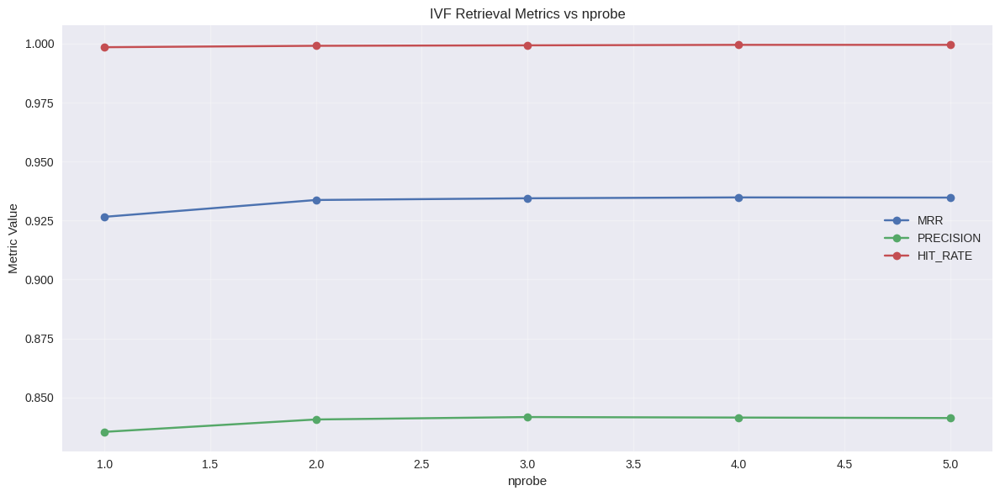

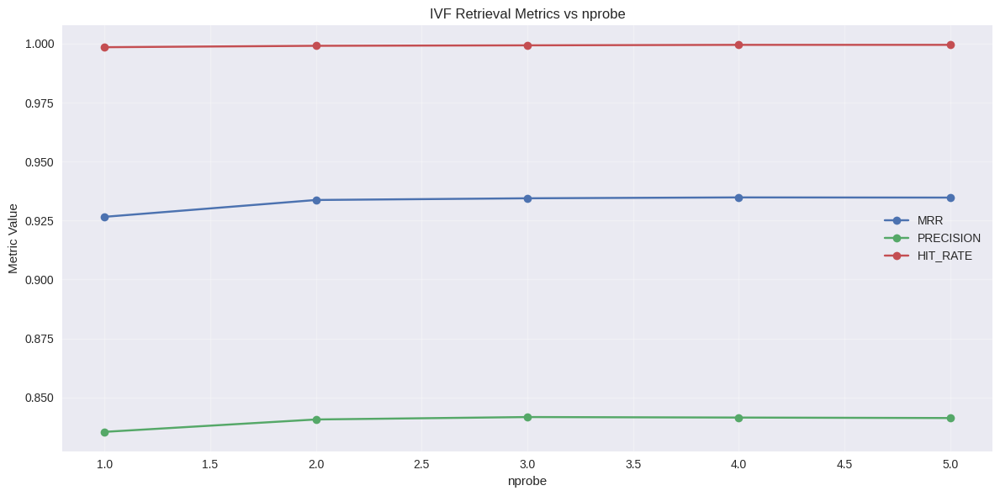

In [24]:
# Set parameters
k = 100
n_clusters = 10  # Since we have 10 classes
nprobe_values = [1, 2, 3, 4, 5]  # Test different nprobe values

# Run evaluation
results = evaluate_ivf_retrieval(
    test_embeddings,
    train_embeddings,
    test_labels,
    train_labels,
    n_clusters=n_clusters,
    nprobe_values=nprobe_values,
    k=k
)

# Plot results
plot_ivf_metrics(results)

In [25]:
def plot_cluster_distribution(ivf: IVF):
    """
    Plot the distribution of points across clusters.
    
    Args:
        ivf: Fitted IVF instance
    """
    # Get cluster sizes
    cluster_sizes = ivf.get_cluster_sizes()
    
    # Create figure
    plt.figure(figsize=(12, 6))
    
    # Plot bar chart
    bars = plt.bar(range(len(cluster_sizes)), cluster_sizes)
    
    # Customize plot
    plt.title('Distribution of Points Across Clusters', pad=15)
    plt.xlabel('Cluster ID')
    plt.ylabel('Number of Points')
    plt.grid(True, alpha=0.3, linestyle='--')
    
    # Add value labels on top of bars
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height,
                f'{int(height)}',
                ha='center', va='bottom')
    
    # Add statistics as text box
    stats_text = (
        f'Statistics:\n'
        f'Mean points/cluster: {np.mean(cluster_sizes):.1f}\n'
        f'Std: {np.std(cluster_sizes):.1f}\n'
        f'Min: {np.min(cluster_sizes)}\n'
        f'Max: {np.max(cluster_sizes)}\n'
        f'Total points: {np.sum(cluster_sizes)}'
    )
    
    plt.text(0.95, 0.95, stats_text,
             transform=plt.gca().transAxes,
             verticalalignment='top',
             horizontalalignment='right',
             bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))
    
    plt.tight_layout()
    return plt.gcf()

def plot_average_comparisons(ivf: IVF, query_vectors: np.ndarray, nprobe_values: List[int]):
    """
    Plot average number of comparisons vs nprobe.
    
    Args:
        ivf: Fitted IVF instance
        query_vectors: Set of query vectors to test
        nprobe_values: List of nprobe values to evaluate
    """
    # Compute average comparisons for each nprobe value
    comparisons = ivf.compute_average_comparisons(query_vectors, nprobe_values)
    
    # Create figure
    plt.figure(figsize=(10, 6))
    
    # Plot line with markers
    plt.plot(list(comparisons.keys()), list(comparisons.values()), 
             marker='o', linestyle='-', linewidth=2, markersize=8)
    
    # Customize plot
    plt.title('Average Number of Comparisons vs nprobe', pad=15)
    plt.xlabel('nprobe (Number of Clusters Searched)')
    plt.ylabel('Average Comparisons per Query')
    plt.grid(True, alpha=0.3, linestyle='--')
    
    # Add value labels
    for nprobe, avg_comp in comparisons.items():
        plt.text(nprobe, avg_comp, f'{int(avg_comp)}', 
                ha='center', va='bottom')
    
    # Add total database size as reference line
    total_points = sum(ivf.get_cluster_sizes())
    plt.axhline(y=total_points, color='r', linestyle='--', alpha=0.5)
    plt.text(plt.xlim()[1], total_points, 
             f'Total Database Size: {total_points}', 
             ha='right', va='bottom', color='r')
    
    plt.tight_layout()
    return plt.gcf()

Testing nprobe=10: 100%|██████████| 10000/10000 [00:00<00:00, 86411.72it/s]


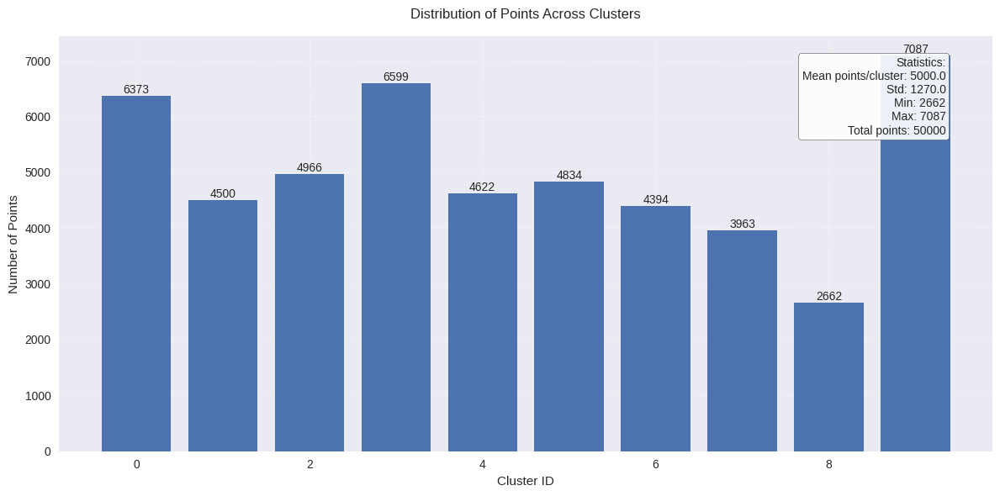

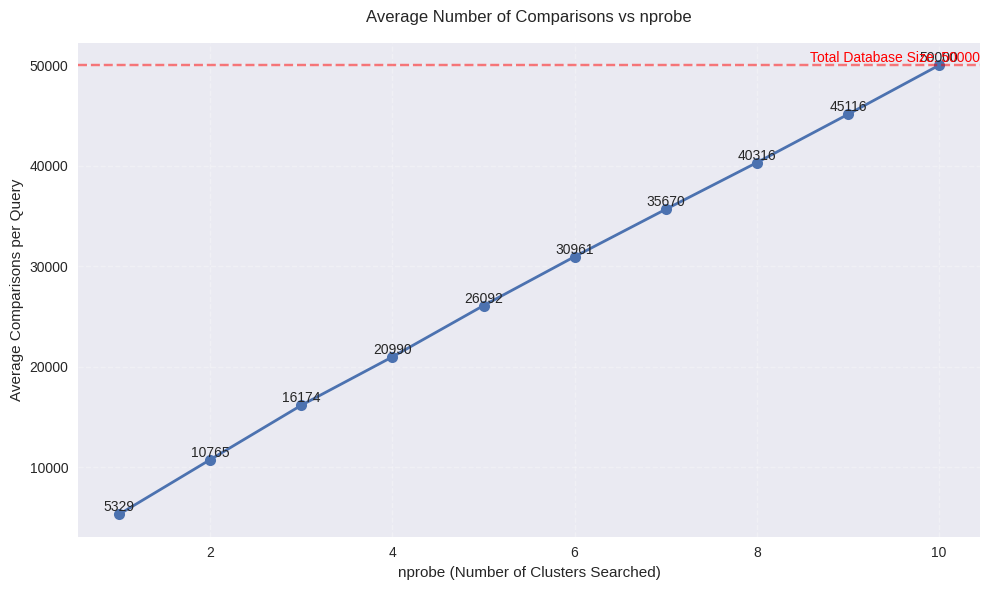

In [26]:
# Plot cluster distribution
fig1 = plot_cluster_distribution(ivf)

# Plot average comparisons
nprobe_values = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
fig2 = plot_average_comparisons(ivf, test_embeddings, nprobe_values)

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from typing import List, Dict
import time
from tqdm import tqdm

class MethodComparison:
    def __init__(self, train_embeddings, test_embeddings, train_labels, test_labels):
        self.train_embeddings = train_embeddings
        self.test_embeddings = test_embeddings
        self.train_labels = train_labels
        self.test_labels = test_labels
        
    def evaluate_all_methods(self, k=100, lsh_bits=8, ivf_clusters=10, ivf_nprobe=3):
        """
        Evaluate all three methods (KNN, LSH, IVF) on the same task.
        Returns performance metrics and comparison counts.
        """
        results = {}
        
        # Evaluate KNN
        print("\nEvaluating KNN...")
        knn_start = time.time()
        knn_metrics, knn_comparisons = self.evaluate_knn(k)
        knn_time = time.time() - knn_start
        results['KNN'] = {
            'metrics': knn_metrics,
            'comparisons': knn_comparisons,
            'time': knn_time
        }
        
        # Evaluate LSH
        print("\nEvaluating LSH...")
        lsh = LSH(n_bits=lsh_bits)
        lsh.fit(self.train_embeddings)
        lsh_start = time.time()
        lsh_metrics, lsh_comparisons = self.evaluate_lsh(lsh, k)
        lsh_time = time.time() - lsh_start
        results['LSH'] = {
            'metrics': lsh_metrics,
            'comparisons': lsh_comparisons,
            'time': lsh_time
        }
        
        # Evaluate IVF
        print("\nEvaluating IVF...")
        ivf = IVF(n_clusters=ivf_clusters)
        ivf.fit(self.train_embeddings)
        ivf_start = time.time()
        ivf_metrics, ivf_comparisons = self.evaluate_ivf(ivf, k, ivf_nprobe)
        ivf_time = time.time() - ivf_start
        results['IVF'] = {
            'metrics': ivf_metrics,
            'comparisons': ivf_comparisons,
            'time': ivf_time
        }
        
        return results
    
    def evaluate_knn(self, k):
        """Evaluate KNN method"""
        metrics = {'mrr': [], 'precision': [], 'hit_rate': []}
        total_comparisons = len(self.train_embeddings)  # KNN always compares with all points
        
        for query_idx in tqdm(range(len(self.test_embeddings))):
            query = self.test_embeddings[query_idx]
            query_label = self.test_labels[query_idx]
            
            # Get nearest neighbors
            distances = np.linalg.norm(self.train_embeddings - query, axis=1)
            nearest_indices = np.argsort(distances)[:k]
            
            # Calculate metrics
            self._calculate_metrics(nearest_indices, query_label, metrics)
            
        return {
            'mrr': np.mean(metrics['mrr']),
            'precision': np.mean(metrics['precision']),
            'hit_rate': np.mean(metrics['hit_rate'])
        }, total_comparisons
    
    # def evaluate_lsh(self, lsh, k):
    #     """Evaluate LSH method"""
    #     metrics = {'mrr': [], 'precision': [], 'hit_rate': []}
    #     comparison_counts = []
        
    #     for query_idx in tqdm(range(len(self.test_embeddings))):
    #         query = self.test_embeddings[query_idx]
    #         query_label = self.test_labels[query_idx]
            
    #         # Get nearest neighbors and count comparisons
    #         nearest_indices, _ = lsh.query(query, k=k)
    #         comparisons = len(lsh.get_candidates(query))  # Add method to LSH class
    #         comparison_counts.append(comparisons)
            
    #         if nearest_indices:
    #             self._calculate_metrics(nearest_indices, query_label, metrics)
            
    #     return {
    #         'mrr': np.mean(metrics['mrr']),
    #         'precision': np.mean(metrics['precision']),
    #         'hit_rate': np.mean(metrics['hit_rate'])
    #     }, np.mean(comparison_counts)
    def evaluate_lsh(self, lsh, k):
        """Evaluate LSH method"""
        metrics = {'mrr': [], 'precision': [], 'hit_rate': []}
        comparison_counts = []
        
        for query_idx in tqdm(range(len(self.test_embeddings))):
            query = self.test_embeddings[query_idx]
            query_label = self.test_labels[query_idx]
            
            # Get nearest neighbors
            nearest_indices, _ = lsh.query(query, k=k, strategy='distance')
            
            # Count total candidates considered across all tables
            candidates = lsh.get_candidates(query)
            comparison_counts.append(len(candidates))
            
            if nearest_indices:
                self._calculate_metrics(nearest_indices, query_label, metrics)
            
        return {
            'mrr': np.mean(metrics['mrr']),
            'precision': np.mean(metrics['precision']),
            'hit_rate': np.mean(metrics['hit_rate'])
        }, np.mean(comparison_counts)
    
    def evaluate_ivf(self, ivf, k, nprobe):
        """Evaluate IVF method"""
        metrics = {'mrr': [], 'precision': [], 'hit_rate': []}
        comparison_counts = []
        
        for query_idx in tqdm(range(len(self.test_embeddings))):
            query = self.test_embeddings[query_idx]
            query_label = self.test_labels[query_idx]
            
            # Get nearest neighbors and count comparisons
            nearest_indices, _ = ivf.query(query, k=k, nprobe=nprobe)
            comparisons = ivf.get_query_comparisons(query, nprobe)  # Add method to IVF class
            comparison_counts.append(comparisons)
            
            if nearest_indices:
                self._calculate_metrics(nearest_indices, query_label, metrics)
            
        return {
            'mrr': np.mean(metrics['mrr']),
            'precision': np.mean(metrics['precision']),
            'hit_rate': np.mean(metrics['hit_rate'])
        }, np.mean(comparison_counts)
    
    def _calculate_metrics(self, nearest_indices, query_label, metrics):
        """Helper function to calculate retrieval metrics"""
        relevant_indices = set(np.where(self.train_labels == query_label)[0])
        retrieved_indices = set(nearest_indices)
        
        # Hit Rate
        hit_rate = 1 if len(relevant_indices.intersection(retrieved_indices)) > 0 else 0
        metrics['hit_rate'].append(hit_rate)
        
        # Precision
        precision = len(relevant_indices.intersection(retrieved_indices)) / len(nearest_indices)
        metrics['precision'].append(precision)
        
        # MRR
        mrr = 0
        for rank, idx in enumerate(nearest_indices):
            if idx in relevant_indices:
                mrr = 1.0 / (rank + 1)
                break
        metrics['mrr'].append(mrr)

def plot_performance_comparison(results: Dict):
    """Plot performance metrics comparison for all methods"""
    metrics = ['mrr', 'precision', 'hit_rate']
    methods = list(results.keys())
    
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    for i, metric in enumerate(metrics):
        values = [results[method]['metrics'][metric] for method in methods]
        
        axes[i].bar(methods, values)
        axes[i].set_title(f'{metric.upper()} Comparison')
        axes[i].set_ylabel('Score')
        axes[i].grid(True, alpha=0.3)
        
        # Add value labels
        for j, v in enumerate(values):
            axes[i].text(j, v, f'{v:.3f}', ha='center', va='bottom')
    
    plt.tight_layout()
    return fig

def plot_computational_comparison(results: Dict):
    """Plot computational efficiency comparison"""
    methods = list(results.keys())
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    
    # Plot average comparisons
    comparisons = [results[method]['comparisons'] for method in methods]
    ax1.bar(methods, comparisons)
    ax1.set_title('Average Comparisons per Query')
    ax1.set_ylabel('Number of Comparisons')
    ax1.grid(True, alpha=0.3)
    
    # Add value labels
    for i, v in enumerate(comparisons):
        ax1.text(i, v, f'{int(v)}', ha='center', va='bottom')
    
    # Plot query times
    times = [results[method]['time'] for method in methods]
    ax2.bar(methods, times)
    ax2.set_title('Total Query Time')
    ax2.set_ylabel('Time (seconds)')
    ax2.grid(True, alpha=0.3)
    
    # Add value labels
    for i, v in enumerate(times):
        ax2.text(i, v, f'{v:.2f}s', ha='center', va='bottom')
    
    plt.tight_layout()
    return fig


Evaluating KNN...


100%|██████████| 10000/10000 [16:38<00:00, 10.01it/s]



Evaluating LSH...


100%|██████████| 10000/10000 [02:48<00:00, 59.19it/s]
/home/mayank/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)



Evaluating IVF...
Training k-means...
Building inverted lists...


100%|██████████| 10000/10000 [11:32<00:00, 14.43it/s]


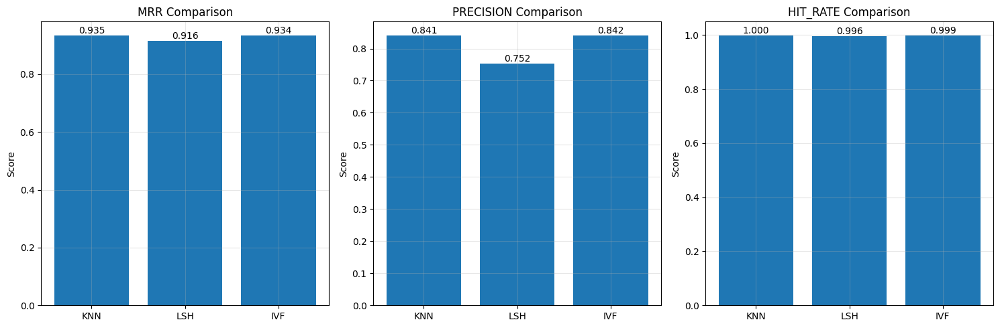

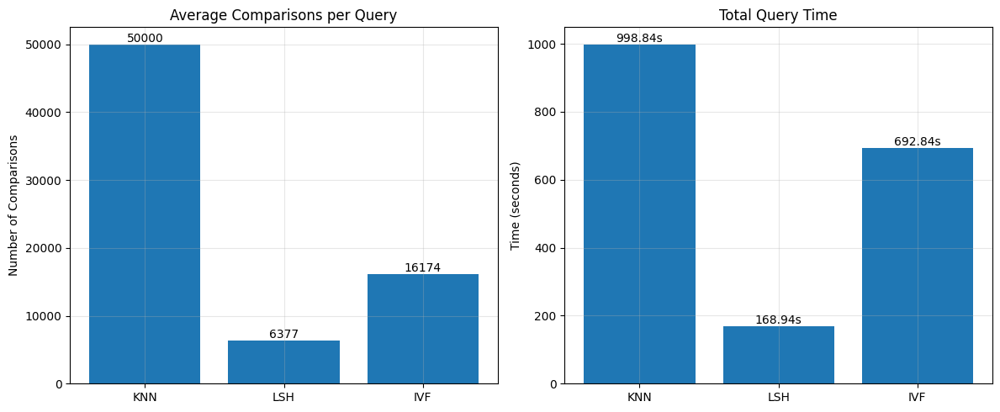

In [10]:
# Initialize comparison
comparison = MethodComparison(train_embeddings, test_embeddings, train_labels, test_labels)

# Evaluate all methods
results = comparison.evaluate_all_methods(
    k=100,              # Number of neighbors to retrieve
    lsh_bits=8,         # Number of LSH bits
    ivf_clusters=10,    # Number of IVF clusters
    ivf_nprobe=3        # Number of IVF clusters to probe
)

# Plot performance comparison
fig1 = plot_performance_comparison(results)

# Plot computational comparison
fig2 = plot_computational_comparison(results)

## 4) The Crypto Detective

### 4.1 Preprocessing and Exploratory Data Analysis

In [9]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier, plot_tree
import matplotlib.pyplot as plt
import seaborn as sns
from time import time
import warnings
warnings.filterwarnings('ignore')

In [10]:
def load_and_preprocess_data(train_path, test_path, val_path):
    train_df = pd.read_csv(train_path)
    test_df = pd.read_csv(test_path)
    val_df = pd.read_csv(val_path)
    y_train = train_df['FLAG']  # Replace 'target' with the actual label column
    X_train = train_df.drop(columns=['FLAG','Address'])
    y_test = test_df['FLAG']  # Replace 'target' with the actual label column
    X_test = test_df.drop(columns=['FLAG','Address'])
    y_val = val_df['FLAG']  # Replace 'target' with the actual label column
    X_val = val_df.drop(columns=['FLAG','Address'])
    print("Missing values in training dataset:\n", train_df.isnull().sum())
    print("Missing values in test dataset:\n", test_df.isnull().sum())
    print("Missing values in validation dataset:\n", val_df.isnull().sum())

    # Feature Scaling (if needed)
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)
    X_val = scaler.transform(X_val)

    return X_train, y_train, X_test, y_test, X_val, y_val

In [ ]:
X_train, y_train, X_test, y_test, X_val, y_val = load_and_preprocess_data("Q4/train_data.csv", "Q4/test_data.csv", "Q4/val_data.csv")


Missing values in training dataset:
 Address                                                 0
FLAG                                                    0
Avg min between sent tnx                                0
Avg min between received tnx                            0
Time Diff between first and last (Mins)                 0
Unique Received From Addresses                          0
min value received                                      0
max value received                                      0
avg val received                                        0
min val sent                                            0
avg val sent                                            0
total transactions (including tnx to create contract    0
total ether received                                    0
total ether balance                                     0
dtype: int64
Missing values in test dataset:
 Address                                                 0
FLAG                                           

### Since there is no missing value in any dataset and also we have removed unneccesary features like Address and also did the scaling

In [43]:
X_train.shape

(9059, 12)

In [44]:
X_test.shape

(2831, 12)

In [12]:
def plot_correlation_matrix(df):
    plt.figure(figsize=(12, 10))
    sns.heatmap(df.corr(), annot=True, cmap='coolwarm', center=0)
    plt.title('Feature Correlation Matrix')
    plt.tight_layout()
    plt.show()

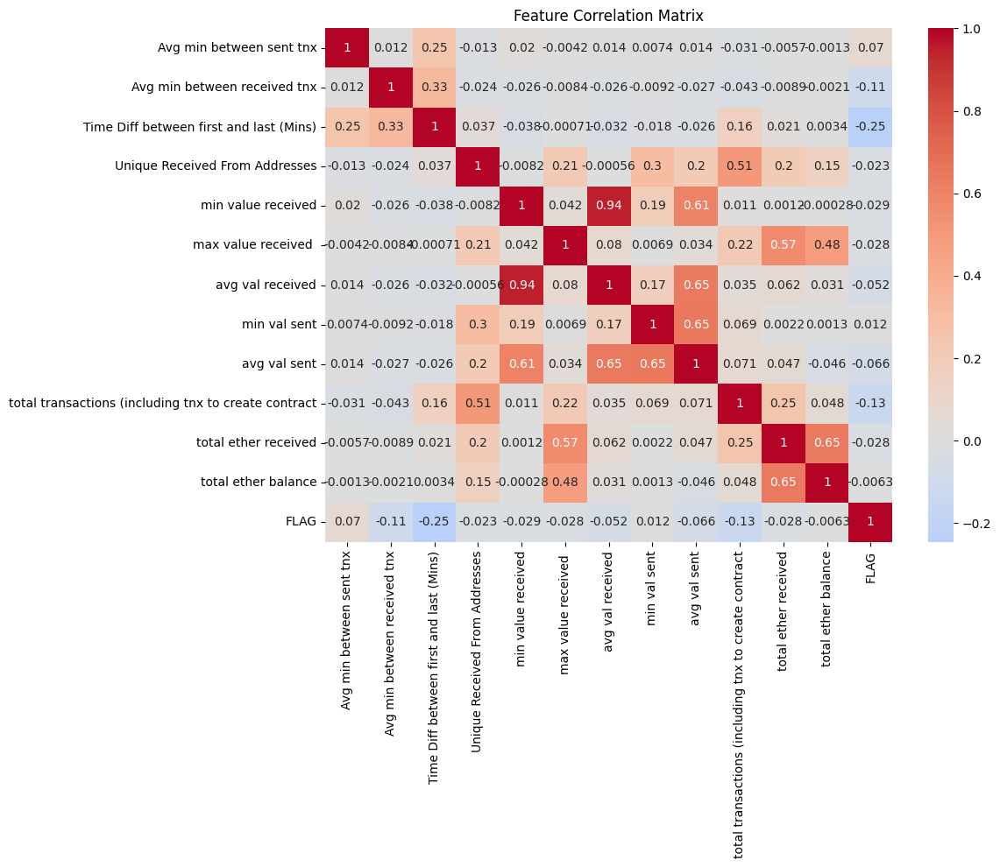

In [ ]:
feature_names = ['Avg min between sent tnx',
       'Avg min between received tnx',
       'Time Diff between first and last (Mins)',
       'Unique Received From Addresses', 'min value received',
       'max value received ', 'avg val received', 'min val sent',
       'avg val sent', 'total transactions (including tnx to create contract',
       'total ether received', 'total ether balance']
    # Plot correlation matrix and violin plots
df = pd.DataFrame(X_train, columns=feature_names)
df['FLAG'] = y_train
plot_correlation_matrix(df)

### From the correlation matrix, the following observations can be made:

- Strong Positive Correlations:
    - avg val received has a very strong positive correlation with min value received (0.94). This indicates that as the average value of received transactions increases, the minimum value received also tends to increase proportionally.
    - avg val sent is highly correlated with avg value received and min val sent. 
    - total ether received has a strong positive correlation with total ether balance (0.65), showing that accounts with higher ether received tend to retain more ether in their balance.

- Moderate Positive Correlations:
    - Unique Received From Addresses is moderately correlated with total transactions (including trx to create contract) (0.51). This implies that accounts interacting with more unique addresses are involved in more transactions.
    - max value received shows moderate correlation with total ether received (0.57) and total ether balance (0.48). Higher maximum transaction values received contribute to both ether received and the balance.

- Negative Correlations with the Target Variable (FLAG):
    - Avg min between received tnx has a negative correlation with FLAG (-0.11). This suggests that accounts with longer intervals between receiving transactions may have a lower likelihood of the flag being triggered.
    - Time Diff between first and last (Mins) is negatively correlated with FLAG (-0.25). Accounts active over a longer time tend to be less likely flagged.

- Weaker or No Correlation:
    - Features like avg val sent, min val sent, and Unique Received From Addresses have almost no significant correlation with FLAG, indicating that these features might not be as relevant for predicting the target variable.
    - total transactions (including trx to create contract) shows weak negative correlation with FLAG (-0.13).

- Interesting Observations in Feature Relationships:
    - min val sent and avg val sent are highly correlated (0.65), suggesting a proportional relationship between the minimum and average values sent in transactions.
    - total ether received has strong correlations with both total ether balance and avg val received, indicating that ether balance and average received value are influenced by the overall ether received.

In [47]:
def plot_violin_plots(df):
    features = df.columns.drop('FLAG')
    n_features = len(features)
    n_cols = 3
    n_rows = (n_features + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5*n_rows))
    axes = axes.flatten()
    
    for i, feature in enumerate(features):
        sns.violinplot(data=df, x='FLAG', y=feature, ax=axes[i])
        axes[i].set_title(feature)
    
    plt.tight_layout()
    plt.show()

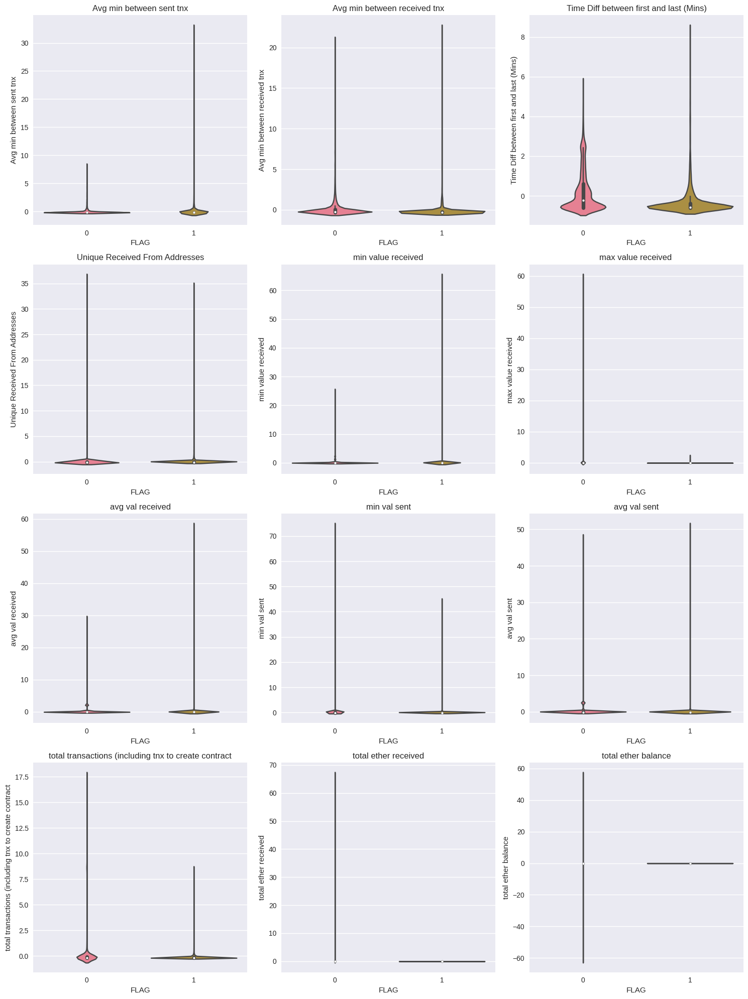

In [48]:
plot_violin_plots(df)


### From the violin plots, here are the observations for each feature in relation to the FLAG variable:

- Avg min between sent tnx:
        For both FLAG = 0 and FLAG = 1, the distribution is heavily concentrated near zero.
        A small number of outliers exist, with slightly longer intervals for FLAG = 0.

- Avg min between received tnx:
        The distribution for FLAG = 1 is more spread out compared to FLAG = 0.
        FLAG = 0 has a significant concentration near zero, while FLAG = 1 shows a wider range of intervals.

- Time Diff between first and last (Mins):
        The distribution for FLAG = 1 is broader, indicating that flagged accounts are active over shorter periods.
        For FLAG = 0,  accounts have smaller and longer time differences, with fewer accounts having long periods of activity.

- Unique Received From Addresses:
        The distribution for both FLAG = 0 and FLAG = 1 is concentrated at the lower end, suggesting most accounts interact with only a few unique addresses.
        A small subset of flagged accounts interacts with many addresses.

- min value received:
        Both FLAG = 0 and FLAG = 1 have distributions concentrated near the lower values, with a few flagged accounts receiving higher minimum values.

- max value received:
        Flagged accounts (FLAG = 1) show a broader spread in the maximum value received, with some accounts receiving significantly higher values compared to unflagged accounts (FLAG = 0).

- avg val received:
        The average value received is concentrated near lower values for both flags, but flagged accounts exhibit a wider range.

- min val sent:
        Both FLAG = 0 and FLAG = 1 show similar distributions, with most transactions concentrated at lower minimum values sent.

- avg val sent:
        Flagged accounts (FLAG = 1) have a broader spread, indicating higher variability in the average value sent.

- total transactions (including trx to create contract):
        Accounts with FLAG = 1 have a slightly broader spread in the total number of transactions, suggesting that flagged accounts may engage in a wider range of activities.

- total ether received:
        The distribution for both flags is concentrated near zero, with very few accounts receiving significant amounts of ether.
        Flagged accounts (FLAG = 1) show slightly higher values in rare cases.

- total ether balance:
        Flagged accounts have a broader range of balances, with some showing negative balances, while unflagged accounts (FLAG = 0) are primarily concentrated near zero.

### General Observations:

- Accounts with FLAG = 1 (flagged) generally exhibit broader distributions across most features, indicating higher variability in behavior.
- Unflagged accounts (FLAG = 0) tend to have more concentrated distributions, with lower ranges for most features.
- Features like Time Diff between first and last (Mins) and max value received show distinct differences between FLAG = 0 and FLAG = 1, which could be useful for distinguishing flagged accounts.

## 4.2 Fraud Detection Model

In [49]:
class DecisionTree:
    def __init__(self, max_depth=None, min_samples_split=2, criterion='entropy'):
        self.max_depth = max_depth
        self.min_samples_split = min_samples_split
        self.criterion = criterion
        self.tree = None
        self.feature_importance_ = None
        
    def entropy(self, y):
        proportions = np.bincount(y) / len(y)
        entropy = -np.sum([p * np.log2(p) for p in proportions if p > 0])
        return entropy
    
    def gini(self, y):
        proportions = np.bincount(y) / len(y)
        gini = 1 - np.sum([p**2 for p in proportions])
        return gini
    
    def information_gain(self, X, y, split_threshold, feature_idx):
        parent_impurity = self.entropy(y) if self.criterion == 'entropy' else self.gini(y)
        
        left_mask = X[:, feature_idx] <= split_threshold
        right_mask = ~left_mask
        
        if np.sum(left_mask) == 0 or np.sum(right_mask) == 0:
            return 0
        
        left_impurity = self.entropy(y[left_mask]) if self.criterion == 'entropy' else self.gini(y[left_mask])
        right_impurity = self.entropy(y[right_mask]) if self.criterion == 'entropy' else self.gini(y[right_mask])
        
        n = len(y)
        n_left = np.sum(left_mask)
        n_right = n - n_left
        
        weighted_impurity = (n_left/n) * left_impurity + (n_right/n) * right_impurity
        return parent_impurity - weighted_impurity
    
    def find_best_split(self, X, y):
        n_samples, n_features = X.shape
        best_gain = -1
        best_feature = None
        best_threshold = None
        
        for feature_idx in range(n_features):
            thresholds = np.unique(X[:, feature_idx])
            for threshold in thresholds:
                gain = self.information_gain(X, y, threshold, feature_idx)
                if gain > best_gain:
                    best_gain = gain
                    best_feature = feature_idx
                    best_threshold = threshold
                    
        return best_feature, best_threshold, best_gain
    
    class Node:
        def __init__(self, feature=None, threshold=None, left=None, right=None, value=None):
            self.feature = feature
            self.threshold = threshold
            self.left = left
            self.right = right
            self.value = value
    
    def _build_tree(self, X, y, depth=0):
        n_samples, n_features = X.shape
        n_classes = len(np.unique(y))
        
        # Stopping criteria
        if (self.max_depth is not None and depth >= self.max_depth) or \
           n_samples < self.min_samples_split or \
           n_classes == 1:
            return self.Node(value=np.bincount(y).argmax())
        
        feature_idx, threshold, gain = self.find_best_split(X, y)
        
        if gain == 0:
            return self.Node(value=np.bincount(y).argmax())
        
        # Split the data
        left_mask = X[:, feature_idx] <= threshold
        right_mask = ~left_mask
        
        # Recursively build left and right subtrees
        left = self._build_tree(X[left_mask], y[left_mask], depth + 1)
        right = self._build_tree(X[right_mask], y[right_mask], depth + 1)
        
        return self.Node(feature=feature_idx, threshold=threshold, left=left, right=right)
    
    def fit(self, X, y):
        self.n_features_ = X.shape[1]
        self.tree = self._build_tree(X, y)
        self._calculate_feature_importance(X, y)
        return self
    
    def _predict_single(self, x, node):
        if node.value is not None:
            return node.value
        
        if x[node.feature] <= node.threshold:
            return self._predict_single(x, node.left)
        return self._predict_single(x, node.right)
    
    def predict(self, X):
        return np.array([self._predict_single(x, self.tree) for x in X])
    
    def _calculate_feature_importance(self, X, y):
        self.feature_importance_ = np.zeros(self.n_features_)
        
        def traverse_tree(node, sample_indices):
            if node.value is not None:
                return
                
            feature_idx = node.feature
            threshold = node.threshold
            
            # Use sample indices for the current node
            X_node = X[sample_indices]
            y_node = y[sample_indices]
            
            # Create masks for the current node's samples
            left_mask = X_node[:, feature_idx] <= threshold
            right_mask = ~left_mask
            
            n_samples = len(sample_indices)
            n_left = np.sum(left_mask)
            n_right = n_samples - n_left
            
            # Calculate importance
            if self.criterion == 'entropy':
                current_impurity = self.entropy(y_node)
                left_impurity = self.entropy(y_node[left_mask]) if n_left > 0 else 0
                right_impurity = self.entropy(y_node[right_mask]) if n_right > 0 else 0
            else:
                current_impurity = self.gini(y_node)
                left_impurity = self.gini(y_node[left_mask]) if n_left > 0 else 0
                right_impurity = self.gini(y_node[right_mask]) if n_right > 0 else 0
            
            # Calculate impurity decrease
            impurity_decrease = current_impurity - (
                (n_left/n_samples) * left_impurity + 
                (n_right/n_samples) * right_impurity
            )
            
            # Update feature importance
            self.feature_importance_[feature_idx] += (n_samples/len(y)) * impurity_decrease
            
            # Recursively traverse left and right subtrees with corresponding sample indices
            left_indices = sample_indices[left_mask]
            right_indices = sample_indices[right_mask]
            
            if n_left > 0:
                traverse_tree(node.left, left_indices)
            if n_right > 0:
                traverse_tree(node.right, right_indices)
        
        # Start traversal with all sample indices
        traverse_tree(self.tree, np.arange(len(y)))
        
        # Normalize feature importances
        if np.sum(self.feature_importance_) > 0:
            self.feature_importance_ /= np.sum(self.feature_importance_)

In [50]:
def compare_models(X_train, X_val, X_test, y_train, y_val, y_test, feature_names):
    # Custom implementation
    custom_tree = DecisionTree(max_depth=5, min_samples_split=2, criterion='entropy')
    t0 = time()
    custom_tree.fit(X_train, y_train)
    custom_time = time() - t0
    
    custom_train_acc = np.mean(custom_tree.predict(X_train) == y_train)
    custom_val_acc = np.mean(custom_tree.predict(X_val) == y_val)
    custom_test_acc = np.mean(custom_tree.predict(X_test) == y_test)
    
    # Scikit-learn implementation
    sklearn_tree = DecisionTreeClassifier(max_depth=5, min_samples_split=2, criterion='entropy')
    t0 = time()
    sklearn_tree.fit(X_train, y_train)
    sklearn_time = time() - t0
    
    sklearn_train_acc = sklearn_tree.score(X_train, y_train)
    sklearn_val_acc = sklearn_tree.score(X_val, y_val)
    sklearn_test_acc = sklearn_tree.score(X_test, y_test)
    
    # Plot comparison
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    
    # Accuracy comparison
    labels = ['Train', 'Validation', 'Test']
    custom_acc = [custom_train_acc, custom_val_acc, custom_test_acc]
    sklearn_acc = [sklearn_train_acc, sklearn_val_acc, sklearn_test_acc]
    
    x = np.arange(len(labels))
    width = 0.35
    
    ax1.bar(x - width/2, custom_acc, width, label='Custom Implementation')
    ax1.bar(x + width/2, sklearn_acc, width, label='Scikit-learn')
    ax1.set_ylabel('Accuracy')
    ax1.set_title('Model Performance Comparison')
    ax1.set_xticks(x)
    ax1.set_xticklabels(labels)
    ax1.legend()
    
    # Feature importance comparison
    custom_importance = custom_tree.feature_importance_
    sklearn_importance = sklearn_tree.feature_importances_
    
    feature_idx = np.arange(len(feature_names))
    
    ax2.bar(feature_idx - width/2, custom_importance, width, label='Custom Implementation')
    ax2.bar(feature_idx + width/2, sklearn_importance, width, label='Scikit-learn')
    ax2.set_ylabel('Feature Importance')
    ax2.set_title('Feature Importance Comparison')
    ax2.set_xticks(feature_idx)
    ax2.set_xticklabels(feature_names, rotation=45, ha='right')
    ax2.legend()
    
    plt.tight_layout()
    plt.show()
    
    return {
        'custom_time': custom_time,
        'sklearn_time': sklearn_time,
        'custom_accuracies': custom_acc,
        'sklearn_accuracies': sklearn_acc
    }

In [51]:
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_val shape:", X_val.shape)
print("y_val shape:", y_val.shape)
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)


X_train shape: (9059, 12)
y_train shape: (9059,)
X_val shape: (2265, 12)
y_val shape: (2265,)
X_test shape: (2831, 12)
y_test shape: (2831,)


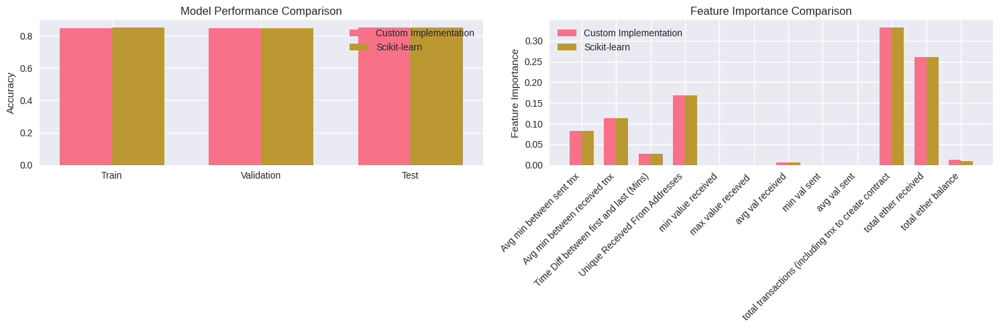

In [52]:
comparison_results = compare_models(X_train, X_val, X_test, y_train, y_val, y_test, feature_names)


In [53]:
print(comparison_results['custom_time'])
print(comparison_results['sklearn_time'])
print(comparison_results['custom_accuracies'])
print(comparison_results['sklearn_accuracies'])

45.76770210266113
0.03616189956665039
[0.8485484049012032, 0.8445916114790287, 0.8519957612151183]
[0.849100342201126, 0.8445916114790287, 0.8523489932885906]


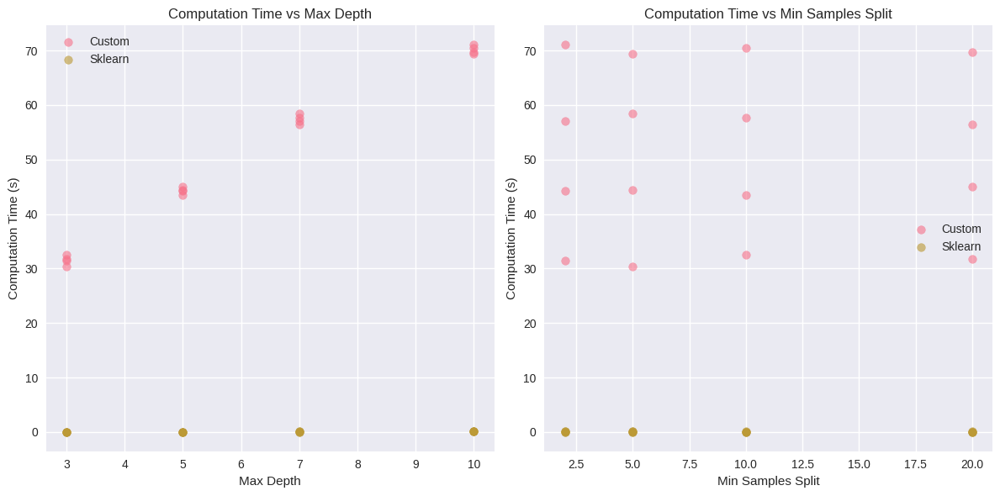

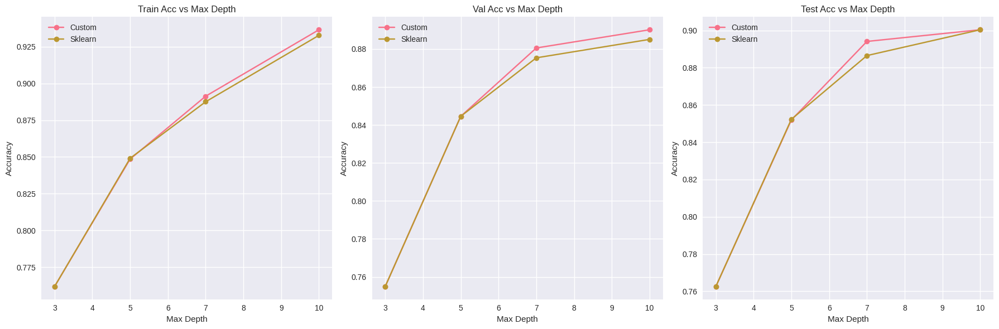

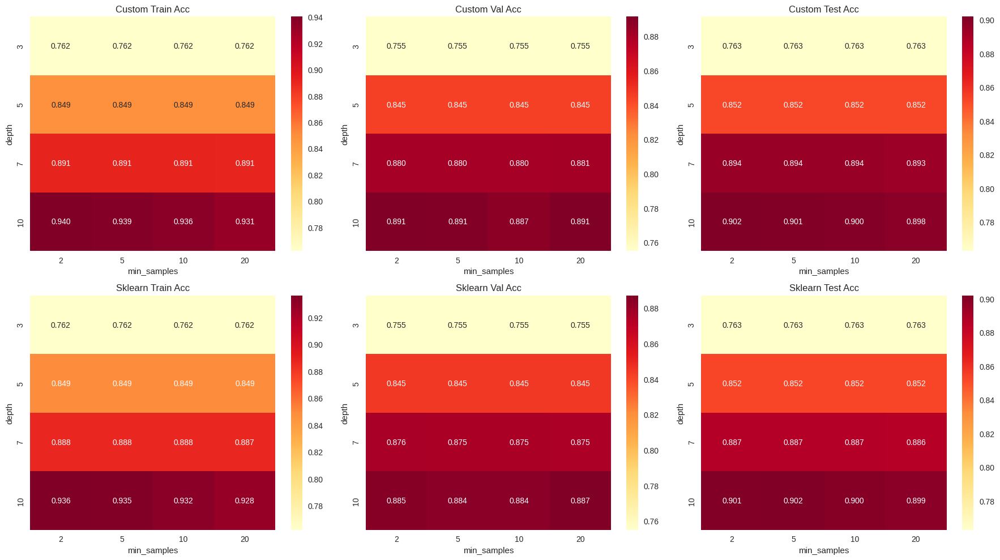

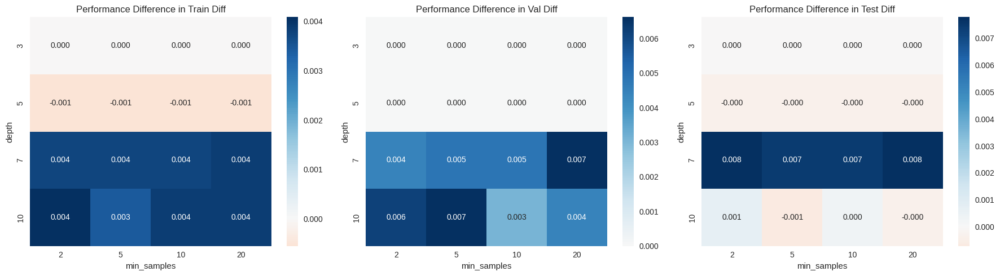

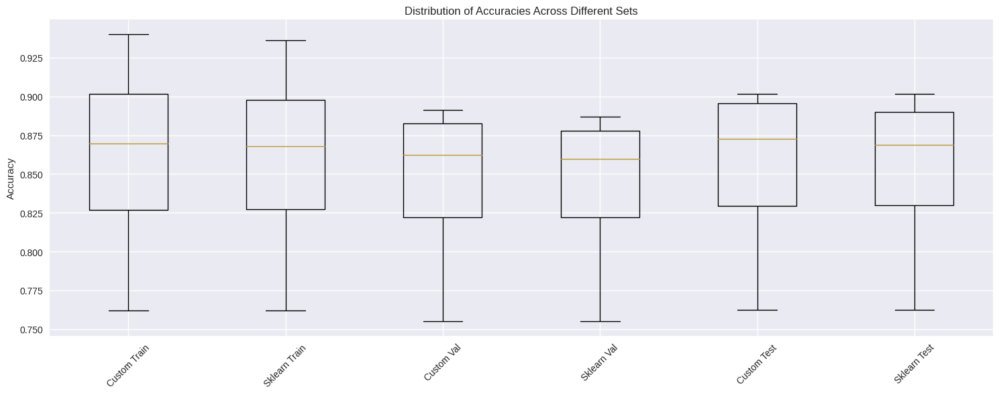

Performance Summary:

Accuracy Statistics:

Train Acc:
Custom Implementation:
  Mean: 0.8596
  Std: 0.0665
  Max: 0.9402

Sklearn Implementation:
  Mean: 0.8578
  Std: 0.0649
  Max: 0.9361

Val Acc:
Custom Implementation:
  Mean: 0.8426
  Std: 0.0551
  Max: 0.8914

Sklearn Implementation:
  Mean: 0.8400
  Std: 0.0530
  Max: 0.8870

Test Acc:
Custom Implementation:
  Mean: 0.8523
  Std: 0.0568
  Max: 0.9018

Sklearn Implementation:
  Mean: 0.8505
  Std: 0.0554
  Max: 0.9018

Computation Time Statistics:
Custom Implementation:
  Mean: 50.8498 seconds
  Std: 14.9147 seconds

Sklearn Implementation:
  Mean: 0.0444 seconds
  Std: 0.0169 seconds


In [54]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.tree import DecisionTreeClassifier
from time import time
from sklearn.metrics import confusion_matrix, classification_report
import plotly.graph_objects as go
from plotly.subplots import make_subplots

def extended_model_comparison(X_train, X_val, X_test, y_train, y_val, y_test, feature_names):
    # Dictionary to store results
    results = {
        'custom': {'times': [], 'accuracies': []},
        'sklearn': {'times': [], 'accuracies': []}
    }
    
    # Test different hyperparameters
    max_depths = [3, 5, 7, 10]
    min_samples = [2, 5, 10, 20]
    
    for depth in max_depths:
        for min_sample in min_samples:
            # Custom implementation
            custom_tree = DecisionTree(max_depth=depth, min_samples_split=min_sample, criterion='entropy')
            t0 = time()
            custom_tree.fit(X_train, y_train)
            custom_time = time() - t0
            
            custom_train_acc = np.mean(custom_tree.predict(X_train) == y_train)
            custom_val_acc = np.mean(custom_tree.predict(X_val) == y_val)
            custom_test_acc = np.mean(custom_tree.predict(X_test) == y_test)
            
            results['custom']['times'].append({
                'depth': depth,
                'min_samples': min_sample,
                'time': custom_time
            })
            results['custom']['accuracies'].append({
                'depth': depth,
                'min_samples': min_sample,
                'train_acc': custom_train_acc,
                'val_acc': custom_val_acc,
                'test_acc': custom_test_acc
            })
            
            # Scikit-learn implementation
            sklearn_tree = DecisionTreeClassifier(max_depth=depth, min_samples_split=min_sample, criterion='entropy')
            t0 = time()
            sklearn_tree.fit(X_train, y_train)
            sklearn_time = time() - t0
            
            sklearn_train_acc = sklearn_tree.score(X_train, y_train)
            sklearn_val_acc = sklearn_tree.score(X_val, y_val)
            sklearn_test_acc = sklearn_tree.score(X_test, y_test)
            
            results['sklearn']['times'].append({
                'depth': depth,
                'min_samples': min_sample,
                'time': sklearn_time
            })
            results['sklearn']['accuracies'].append({
                'depth': depth,
                'min_samples': min_sample,
                'train_acc': sklearn_train_acc,
                'val_acc': sklearn_val_acc,
                'test_acc': sklearn_test_acc
            })
    
    return results

def plot_comparative_analysis(results):
    # Convert results to DataFrames
    custom_times_df = pd.DataFrame(results['custom']['times'])
    sklearn_times_df = pd.DataFrame(results['sklearn']['times'])
    custom_acc_df = pd.DataFrame(results['custom']['accuracies'])
    sklearn_acc_df = pd.DataFrame(results['sklearn']['accuracies'])
    
    # 1. Computation Time Comparison
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.scatter(custom_times_df['depth'], custom_times_df['time'], label='Custom', alpha=0.6)
    plt.scatter(sklearn_times_df['depth'], sklearn_times_df['time'], label='Sklearn', alpha=0.6)
    plt.xlabel('Max Depth')
    plt.ylabel('Computation Time (s)')
    plt.title('Computation Time vs Max Depth')
    plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.scatter(custom_times_df['min_samples'], custom_times_df['time'], label='Custom', alpha=0.6)
    plt.scatter(sklearn_times_df['min_samples'], sklearn_times_df['time'], label='Sklearn', alpha=0.6)
    plt.xlabel('Min Samples Split')
    plt.ylabel('Computation Time (s)')
    plt.title('Computation Time vs Min Samples Split')
    plt.legend()
    plt.tight_layout()
    plt.show()
    
    # 2. Accuracy Comparison - Line plots instead of 3D scatter
    plt.figure(figsize=(18, 6))
    for i, dataset in enumerate(['train_acc', 'val_acc', 'test_acc']):
        plt.subplot(1, 3, i+1)
        
        # Group by depth and plot mean accuracies
        custom_means = custom_acc_df.groupby('depth')[dataset].mean()
        sklearn_means = sklearn_acc_df.groupby('depth')[dataset].mean()
        
        plt.plot(custom_means.index, custom_means.values, 'o-', label='Custom')
        plt.plot(sklearn_means.index, sklearn_means.values, 'o-', label='Sklearn')
        plt.xlabel('Max Depth')
        plt.ylabel('Accuracy')
        plt.title(f'{dataset.replace("_", " ").title()} vs Max Depth')
        plt.legend()
    
    plt.tight_layout()
    plt.show()
    
    # 3. Performance Heatmaps
    fig, axes = plt.subplots(2, 3, figsize=(18, 10))
    
    for i, (impl, acc_df) in enumerate([('Custom', custom_acc_df), ('Sklearn', sklearn_acc_df)]):
        for j, metric in enumerate(['train_acc', 'val_acc', 'test_acc']):
            pivot_table = pd.pivot_table(acc_df, values=metric, 
                                       index='depth', columns='min_samples')
            sns.heatmap(pivot_table, annot=True, fmt='.3f', cmap='YlOrRd',
                       ax=axes[i, j])
            axes[i, j].set_title(f'{impl} {metric.replace("_", " ").title()}')
    
    plt.tight_layout()
    plt.show()
    
    # 4. Performance Difference Analysis
    diff_df = pd.DataFrame({
        'depth': custom_acc_df['depth'],
        'min_samples': custom_acc_df['min_samples'],
        'train_diff': custom_acc_df['train_acc'] - sklearn_acc_df['train_acc'],
        'val_diff': custom_acc_df['val_acc'] - sklearn_acc_df['val_acc'],
        'test_diff': custom_acc_df['test_acc'] - sklearn_acc_df['test_acc']
    })
    
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    
    for i, metric in enumerate(['train_diff', 'val_diff', 'test_diff']):
        pivot_table = pd.pivot_table(diff_df, values=metric, 
                                   index='depth', columns='min_samples')
        sns.heatmap(pivot_table, annot=True, fmt='.3f', cmap='RdBu', center=0,
                   ax=axes[i])
        axes[i].set_title(f'Performance Difference in {metric.replace("_", " ").title()}')
    
    plt.tight_layout()
    plt.show()
    
    # 5. Additional Comparison: Box plots of accuracies
    plt.figure(figsize=(15, 6))
    
    data_to_plot = {
        'Custom Train': custom_acc_df['train_acc'],
        'Sklearn Train': sklearn_acc_df['train_acc'],
        'Custom Val': custom_acc_df['val_acc'],
        'Sklearn Val': sklearn_acc_df['val_acc'],
        'Custom Test': custom_acc_df['test_acc'],
        'Sklearn Test': sklearn_acc_df['test_acc']
    }
    
    plt.boxplot(data_to_plot.values())
    plt.xticks(range(1, len(data_to_plot) + 1), data_to_plot.keys(), rotation=45)
    plt.ylabel('Accuracy')
    plt.title('Distribution of Accuracies Across Different Sets')
    plt.tight_layout()
    plt.show()

# Additional function to analyze and print statistical summary
def print_performance_summary(results):
    custom_acc_df = pd.DataFrame(results['custom']['accuracies'])
    sklearn_acc_df = pd.DataFrame(results['sklearn']['accuracies'])
    custom_times_df = pd.DataFrame(results['custom']['times'])
    sklearn_times_df = pd.DataFrame(results['sklearn']['times'])
    
    print("Performance Summary:")
    print("\nAccuracy Statistics:")
    for dataset in ['train_acc', 'val_acc', 'test_acc']:
        print(f"\n{dataset.replace('_', ' ').title()}:")
        print(f"Custom Implementation:")
        print(f"  Mean: {custom_acc_df[dataset].mean():.4f}")
        print(f"  Std: {custom_acc_df[dataset].std():.4f}")
        print(f"  Max: {custom_acc_df[dataset].max():.4f}")
        print(f"\nSklearn Implementation:")
        print(f"  Mean: {sklearn_acc_df[dataset].mean():.4f}")
        print(f"  Std: {sklearn_acc_df[dataset].std():.4f}")
        print(f"  Max: {sklearn_acc_df[dataset].max():.4f}")
    
    print("\nComputation Time Statistics:")
    print(f"Custom Implementation:")
    print(f"  Mean: {custom_times_df['time'].mean():.4f} seconds")
    print(f"  Std: {custom_times_df['time'].std():.4f} seconds")
    print(f"\nSklearn Implementation:")
    print(f"  Mean: {sklearn_times_df['time'].mean():.4f} seconds")
    print(f"  Std: {sklearn_times_df['time'].std():.4f} seconds")

# Usage:
results = extended_model_comparison(X_train, X_val, X_test, y_train, y_val, y_test, feature_names)
plot_comparative_analysis(results)
print_performance_summary(results)

## Observations 
- Accuracies and feature importance of both custom and in-built sk-learn decision tree implementation is almost giving same results
- With increasing Max_depth and Min_samples_split , computation time of sk-learn based model is very fast and in order of 0 seconds
i.e 0.0444 seconds while custom implementation takes around 30 to 70 seconds 
- After max_depth >5 , all three accuracies of train,test and val of custom based is somewhat more than sk-learn implementation not very difference but slightly more
- For accuracies:-
    - In training :- custom has highest in 0.94 and sklearn has in 0.936 in max_depth = 10 and min_samples = 2
    - In testing :- custom has highest 0.902 and same with sklearn in max_depth = 10
    - in Validation :- custom has highest of 0.91 and sklearn has 0.887
- when depth increases from 3 to 10 accuracies also increases and for min_samples it is mostly reverse trend.

## Analysis
The significant difference in computation time between your custom decision tree implementation (~30-70 seconds) and scikit-learn's DecisionTreeClassifier (~0.044 seconds) can be attributed to several key factors:
1. Optimized Implementation in Scikit-learn

    Scikit-learn’s decision tree is implemented in Cython, a compiled language that is much faster than Python.
    It uses efficient memory management and highly optimized data structures (such as NumPy arrays) for fast traversal and computations.

2. Algorithmic Optimizations

    Scikit-learn leverages vectorized operations, reducing the need for Python loops, which are inherently slow.
    It uses efficient splitting heuristics like the best split selection using sorted values and precomputed statistics.
    Pruning techniques and optimized node splitting strategies further improve speed.

3. Data Structure Differences

    If your custom implementation relies on lists and dictionaries, traversing and modifying them is much slower compared to scikit-learn’s NumPy-based approach.
    Scikit-learn likely uses efficient indexing techniques (e.g., binary search, heap structures) to minimize computational overhead.

4. Default Hyperparameters

    Scikit-learn’s defaults (e.g., min_samples_split=2, max_features=None, min_impurity_decrease=0.0) ensure a balance between accuracy and speed.
    Your custom implementation may not have optimizations for early stopping or best split computation, leading to more exhaustive tree growth.

5. Parallelization & Low-Level Optimizations

    Scikit-learn utilizes parallel processing (especially for tree-based models like RandomForest).
    It avoids redundant calculations by caching results and reusing computed values.
    Your implementation is likely single-threaded and may perform redundant calculations at each node.

6. Python Overhead

    Interpreted Python code runs significantly slower than compiled Cython/C++ in scikit-learn.
    Function calls, recursion, and memory allocation are expensive in Python.


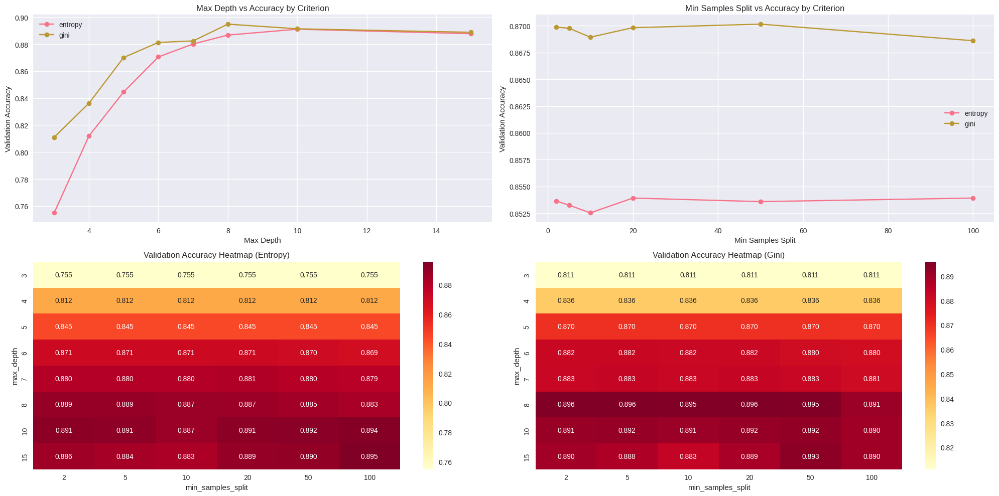


Hyperparameter Tuning Results:

Best Configuration:
Criterion: gini
Max Depth: 8
Min Samples Split: 2
Validation Accuracy: 0.8958
Training Accuracy: 0.9277

Analysis:

1. Impact of Max Depth:
max_depth
3     0.783002
4     0.824062
5     0.857358
6     0.875938
7     0.881273
8     0.890802
10    0.891244
15    0.888300
Name: val_accuracy, dtype: float64

2. Impact of Min Samples Split:
min_samples_split
2      0.861755
5      0.861507
10     0.860734
20     0.861865
50     0.861865
100    0.861258
Name: val_accuracy, dtype: float64

3. Criterion Comparison:
criterion
entropy    0.853477
gini       0.869518
Name: val_accuracy, dtype: float64

4. Overfitting Analysis:
Mean overfitting gap: 0.0209
Max overfitting gap: 0.1030


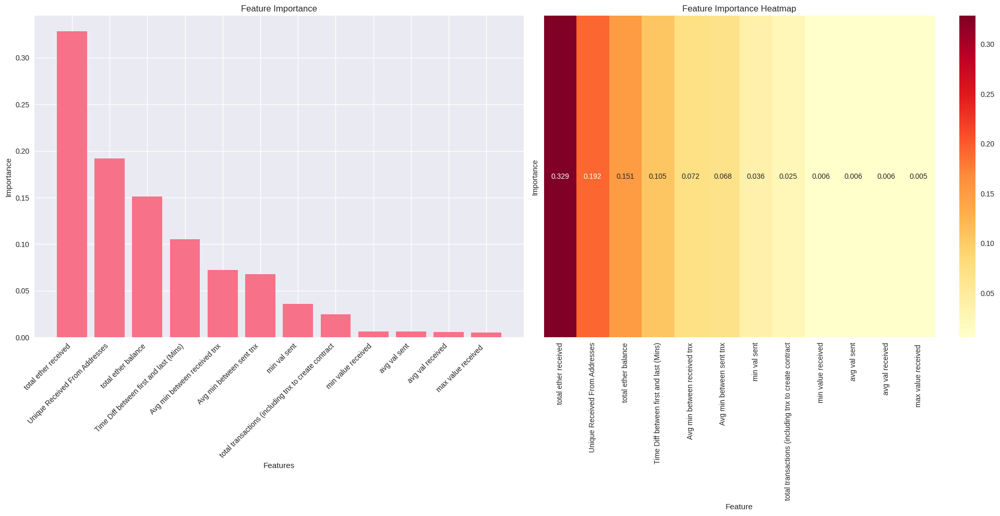

In [60]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.tree import plot_tree, DecisionTreeClassifier
import graphviz
from sklearn.tree import export_graphviz

def hyperparameter_tuning_analysis(X_train, X_val, y_train, y_val, feature_names):
    # Parameters to test
    max_depths = [3, 4, 5, 6, 7, 8, 10, 15]
    min_samples_splits = [2, 5, 10, 20, 50, 100]
    criteria = ['entropy', 'gini']
    
    # Store results
    results = []
    
    # Grid search
    for criterion in criteria:
        for depth in max_depths:
            for min_samples in min_samples_splits:
                # Custom implementation
                custom_tree = DecisionTree(
                    max_depth=depth,
                    min_samples_split=min_samples,
                    criterion=criterion
                )
                custom_tree.fit(X_train, y_train)
                val_score = np.mean(custom_tree.predict(X_val) == y_val)
                train_score = np.mean(custom_tree.predict(X_train) == y_train)
                
                results.append({
                    'criterion': criterion,
                    'max_depth': depth,
                    'min_samples_split': min_samples,
                    'train_accuracy': train_score,
                    'val_accuracy': val_score
                })
    
    results_df = pd.DataFrame(results)
    
    # Plotting
    plt.figure(figsize=(20, 10))
    
    # 1. Max Depth vs Accuracy for different criteria
    plt.subplot(2, 2, 1)
    for criterion in criteria:
        mask = results_df['criterion'] == criterion
        plt.plot(results_df[mask].groupby('max_depth')['val_accuracy'].mean(), 
                marker='o', label=f'{criterion}')
    plt.xlabel('Max Depth')
    plt.ylabel('Validation Accuracy')
    plt.title('Max Depth vs Accuracy by Criterion')
    plt.legend()
    plt.grid(True)
    
    # 2. Min Samples Split vs Accuracy for different criteria
    plt.subplot(2, 2, 2)
    for criterion in criteria:
        mask = results_df['criterion'] == criterion
        plt.plot(results_df[mask].groupby('min_samples_split')['val_accuracy'].mean(), 
                marker='o', label=f'{criterion}')
    plt.xlabel('Min Samples Split')
    plt.ylabel('Validation Accuracy')
    plt.title('Min Samples Split vs Accuracy by Criterion')
    plt.legend()
    plt.grid(True)
    
    # 3. Heatmap for entropy criterion
    plt.subplot(2, 2, 3)
    entropy_results = results_df[results_df['criterion'] == 'entropy']
    pivot_table = entropy_results.pivot_table(
        values='val_accuracy',
        index='max_depth',
        columns='min_samples_split'
    )
    sns.heatmap(pivot_table, annot=True, fmt='.3f', cmap='YlOrRd')
    plt.title('Validation Accuracy Heatmap (Entropy)')
    
    # 4. Heatmap for gini criterion
    plt.subplot(2, 2, 4)
    gini_results = results_df[results_df['criterion'] == 'gini']
    pivot_table = gini_results.pivot_table(
        values='val_accuracy',
        index='max_depth',
        columns='min_samples_split'
    )
    sns.heatmap(pivot_table, annot=True, fmt='.3f', cmap='YlOrRd')
    plt.title('Validation Accuracy Heatmap (Gini)')
    
    plt.tight_layout()
    plt.show()
    
    # Find best parameters
    best_result = results_df.loc[results_df['val_accuracy'].idxmax()]
    return best_result, results_df

def visualize_model(model, X_train, feature_names):
    plt.figure(figsize=(20, 10))
    
    # 1. Feature Importance Bar Plot
    plt.subplot(1, 2, 1)
    importances = model.feature_importance_
    indices = np.argsort(importances)[::-1]
    
    plt.bar(range(len(importances)), importances[indices])
    plt.xticks(range(len(importances)), 
              [feature_names[i] for i in indices], 
              rotation=45, 
              ha='right')
    plt.xlabel('Features')
    plt.ylabel('Importance')
    plt.title('Feature Importance')
    
    # 2. Feature Importance Heatmap
    plt.subplot(1, 2, 2)
    importance_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance': importances
    })
    importance_df = importance_df.sort_values('Importance', ascending=False)
    
    sns.heatmap(
        importance_df.set_index('Feature').T,
        annot=True,
        fmt='.3f',
        cmap='YlOrRd'
    )
    plt.title('Feature Importance Heatmap')
    plt.tight_layout()
    plt.show()
    
    # 3. Tree Visualization using graphviz
    def visualize_tree(tree, feature_names):
        dot_data = export_graphviz(
            tree, 
            out_file=None,
            feature_names=feature_names,
            class_names=['Safe', 'Fraud'],
            filled=True,
            rounded=True,
            special_characters=True,
            max_depth=3  # Limit depth for visibility
        )
        graph = graphviz.Source(dot_data)
        return graph
    
    # For sklearn visualization, train a small tree for better visibility
    sklearn_tree = DecisionTreeClassifier(
        max_depth=3,
        min_samples_split=model.min_samples_split,
        criterion=model.criterion
    )
    sklearn_tree.fit(X_train, y_train)
    
    tree_viz = visualize_tree(sklearn_tree, feature_names)
    return tree_viz

# Function to print analysis
def print_hyperparameter_analysis(best_result, results_df):
    print("\nHyperparameter Tuning Results:")
    print("\nBest Configuration:")
    print(f"Criterion: {best_result['criterion']}")
    print(f"Max Depth: {best_result['max_depth']}")
    print(f"Min Samples Split: {best_result['min_samples_split']}")
    print(f"Validation Accuracy: {best_result['val_accuracy']:.4f}")
    print(f"Training Accuracy: {best_result['train_accuracy']:.4f}")
    
    print("\nAnalysis:")
    print("\n1. Impact of Max Depth:")
    depth_analysis = results_df.groupby('max_depth')['val_accuracy'].mean()
    print(depth_analysis)
    
    print("\n2. Impact of Min Samples Split:")
    samples_analysis = results_df.groupby('min_samples_split')['val_accuracy'].mean()
    print(samples_analysis)
    
    print("\n3. Criterion Comparison:")
    criterion_analysis = results_df.groupby('criterion')['val_accuracy'].mean()
    print(criterion_analysis)
    
    # Calculate overfitting metrics
    overfitting = results_df['train_accuracy'] - results_df['val_accuracy']
    print("\n4. Overfitting Analysis:")
    print(f"Mean overfitting gap: {overfitting.mean():.4f}")
    print(f"Max overfitting gap: {overfitting.max():.4f}")

# Usage
best_params, results_df = hyperparameter_tuning_analysis(X_train, X_val, y_train, y_val, feature_names)
print_hyperparameter_analysis(best_params, results_df)

# Train best model
best_model = DecisionTree(
    max_depth=int(best_params['max_depth']),
    min_samples_split=int(best_params['min_samples_split']),
    criterion=best_params['criterion']
)
best_model.fit(X_train, y_train)

# Visualize the best model
tree_viz = visualize_model(best_model, X_train, feature_names)

In [6]:
tree_viz

NameError: name 'tree_viz' is not defined

## 5) K-Means

In [ ]:
import math
from skimage import io, color
from skimage.transform import resize
import numpy as np

def maintain_aspect_ratio_resize(image, desired_size):
    # Calculate aspect ratio
    old_height, old_width = image.shape[:2]
    aspect_ratio = old_width / old_height
    
    # Calculate new dimensions maintaining aspect ratio
    if aspect_ratio > 1:
        # Width is greater than height
        new_width = desired_size
        new_height = int(desired_size / aspect_ratio)
    else:
        # Height is greater than width
        new_height = desired_size
        new_width = int(desired_size * aspect_ratio)
    
    # Resize image
    resized_image = resize(image, (new_height, new_width), anti_aliasing=True)
    return resized_image

def calc_gradient(h, w, img, img_w, img_h):
    if w + 1 >= img_w:
        w = img_w - 2
    if h + 1 >= img_h:
        h = img_h - 2
    if w < 0:
        w = 0
    if h < 0:
        h = 0
        
    grad = np.sum(img[h+1, w+1] - img[h, w])  # Simplified gradient calculation
    return grad

def make_superPixel(h, w, img):
    return SuperPixels(h, w, img[h,w][0], img[h,w][1], img[h,w][2])

def initial_cluster_center(S, img, img_h, img_w, clusters):
    h = S // 2
    while h < img_h:
        w = S // 2
        while w < img_w:
            clusters.append(make_superPixel(h, w, img))
            w += S
        h += S
    return clusters

def reassign_cluster_center_acc_to_grad(clusters, img, img_w, img_h):
    for c in clusters:
        cluster_gradient = calc_gradient(c.h, c.w, img, img_w, img_h)
        for dh in range(-1, 2):
            for dw in range(-1, 2):
                H = c.h + dh
                W = c.w + dw
                if 0 <= H < img_h and 0 <= W < img_w:  # Boundary check
                    new_gradient = calc_gradient(H, W, img, img_w, img_h)
                    if new_gradient < cluster_gradient:
                        c.update(H, W, img[H,W][0], img[H,W][1], img[H,W][2])
                        cluster_gradient = new_gradient

def assign_pixels_to_cluster(clusters, S, img, img_h, img_w, tag, dis):
    for c in clusters:
        for h in range(max(0, c.h - 2 * S), min(img_h, c.h + 2 * S)):
            for w in range(max(0, c.w - 2 * S), min(img_w, c.w + 2 * S)):
                l, a, b = img[h,w]
                Dc = math.sqrt(math.pow(l - c.l, 2) + math.pow(a - c.a, 2) + math.pow(b - c.b, 2))
                Ds = math.sqrt(math.pow(h - c.h, 2) + math.pow(w - c.w, 2))
                D = math.sqrt(math.pow(Dc / m, 2) + math.pow(Ds / S, 2))
                if D < dis[h,w]:
                    if (h, w) not in tag:
                        tag[(h, w)] = c
                        c.pixels.append((h, w))
                    else:
                        tag[(h, w)].pixels.remove((h, w))
                        tag[(h, w)] = c
                        c.pixels.append((h, w))
                    dis[h, w] = D

def update_cluster_mean(clusters, img):
    for c in clusters:
        if len(c.pixels) > 0:  # Check if cluster has any pixels
            sum_h = sum_w = number = 0
            for p in c.pixels:
                sum_h += p[0]
                sum_w += p[1]
                number += 1
            H = sum_h // number
            W = sum_w // number
            c.update(H, W, img[H, W][0], img[H, W][1], img[H, W][2])

def avg_color_cluster(img, name, clusters):
    image = np.copy(img)
    for c in clusters:
        for p in c.pixels:
            image[p[0],p[1]] = [c.l, c.a, c.b]
        # Mark cluster centers in black
        if 0 <= c.h < image.shape[0] and 0 <= c.w < image.shape[1]:
            image[c.h, c.w] = [0, 0, 0]
    lab2rgb(name, image)

def slic(S, img, img_h, img_w, clusters, tag, dis):
    clusters = initial_cluster_center(S, img, img_h, img_w, clusters)
    reassign_cluster_center_acc_to_grad(clusters, img, img_w, img_h)
    for i in range(10):
        assign_pixels_to_cluster(clusters, S, img, img_h, img_w, tag, dis)
        update_cluster_mean(clusters, img)
        if i == 9:
            name = f'output_m{m}_k{k}.png'
            avg_color_cluster(img, name, clusters)
    return clusters

def lab2rgb(path, lab_arr):
    rgb_arr = color.lab2rgb(lab_arr)
    rgb_arr = (rgb_arr * 255).astype(np.uint8)
    io.imsave(path, rgb_arr)

class SuperPixels(object):
    def __init__(self, h, w, l=0, a=0, b=0):
        self.update(h, w, l, a, b)
        self.pixels = []

    def update(self, h, w, l, a, b):
        self.h = h
        self.w = w
        self.l = l
        self.a = a
        self.b = b

# # Main execution
# desired_size = 1000  # You can adjust this value based on your needs
# k = 3000   # Number of Super pixels
# m = 5    # Constant for normalizing the color proximity

# # Read and resize the image
# rgb = io.imread("2.jpg", plugin='matplotlib')
# rgb_resized = maintain_aspect_ratio_resize(rgb, desired_size)

# # Convert to LAB color space
# img = color.rgb2lab(rgb_resized)
# img_h, img_w = img.shape[:2]

# # Calculate superpixel size
# N = img_h * img_w
# S = int(math.sqrt(N / k))

# # Initialize variables
# clusters = []
# tag = {}
# dis = np.full((img_h, img_w), np.inf)

# # Run SLIC algorithm
# cluster = slic(S, img, img_h, img_w, clusters, tag, dis)

In [ ]:
desired_size = 1000  # You can adjust this value based on your needs
k = 3000   # Number of Super pixels
m = 5    # Constant for normalizing the color proximity

# Read and resize the image
rgb = io.imread("2.jpg", plugin='matplotlib')
rgb_resized = maintain_aspect_ratio_resize(rgb, desired_size)

# Convert to LAB color space
img = color.rgb2lab(rgb_resized)
img_h, img_w = img.shape[:2]

# Calculate superpixel size
N = img_h * img_w
S = int(math.sqrt(N / k))

# Initialize variables
clusters = []
tag = {}
dis = np.full((img_h, img_w), np.inf)

# Run SLIC algorithm
cluster = slic(S, img, img_h, img_w, clusters, tag, dis)

### Doing for both LAB and RGB color space saving each iterations also

In [18]:
import math
import os
from skimage import io, color
from skimage.transform import resize
import numpy as np

def create_output_directories(image_name):
    # Create main directory
    base_dir = f"{image_name}_iterations"
    lab_dir = os.path.join(base_dir, "LAB")
    rgb_dir = os.path.join(base_dir, "RGB")
    
    # Create directories if they don't exist
    for dir_path in [base_dir, lab_dir, rgb_dir]:
        if not os.path.exists(dir_path):
            os.makedirs(dir_path)
    
    return lab_dir, rgb_dir

def save_iteration_image(img, clusters, iteration, lab_dir, rgb_dir, is_final=False):
    image = np.copy(img)
    for c in clusters:
        for p in c.pixels:
            image[p[0],p[1]] = [c.l, c.a, c.b]
        # Mark cluster centers in black
        if 0 <= c.h < image.shape[0] and 0 <= c.w < image.shape[1]:
            image[c.h, c.w] = [0, 0, 0]
    
    # Convert LAB to RGB
    rgb_image = color.lab2rgb(image)
    rgb_image = (rgb_image * 255).astype(np.uint8)
    
    # Save images
    if is_final:
        lab_path = os.path.join(lab_dir, "final_image.jpg")
        rgb_path = os.path.join(rgb_dir, "final_image.jpg")
    else:
        lab_path = os.path.join(lab_dir, f"iteration_{iteration}.jpg")
        rgb_path = os.path.join(rgb_dir, f"iteration_{iteration}.jpg")
    
    # Save LAB version (normalized to 0-255 range for visualization)
    lab_normalized = np.copy(image)
    # Normalize L channel (0 to 100 -> 0 to 255)
    lab_normalized[..., 0] = (image[..., 0] * 255 / 100).clip(0, 255)
    # Normalize a,b channels (-128 to 127 -> 0 to 255)
    lab_normalized[..., 1:] = ((image[..., 1:] + 128) * 255 / 255).clip(0, 255)
    lab_normalized = lab_normalized.astype(np.uint8)
    
    # Save both versions
    io.imsave(lab_path, lab_normalized)
    io.imsave(rgb_path, rgb_image)

def maintain_aspect_ratio_resize(image, desired_size):
    old_height, old_width = image.shape[:2]
    aspect_ratio = old_width / old_height
    
    if aspect_ratio > 1:
        new_width = desired_size
        new_height = int(desired_size / aspect_ratio)
    else:
        new_height = desired_size
        new_width = int(desired_size * aspect_ratio)
    
    resized_image = resize(image, (new_height, new_width), anti_aliasing=True)
    return resized_image

def calc_gradient(h, w, img, img_w, img_h):
    if w + 1 >= img_w:
        w = img_w - 2
    if h + 1 >= img_h:
        h = img_h - 2
    if w < 0:
        w = 0
    if h < 0:
        h = 0
        
    grad = np.sum(img[h+1, w+1] - img[h, w])
    return grad

def make_superPixel(h, w, img):
    return SuperPixels(h, w, img[h,w][0], img[h,w][1], img[h,w][2])

def initial_cluster_center(S, img, img_h, img_w, clusters):
    h = S // 2
    while h < img_h:
        w = S // 2
        while w < img_w:
            clusters.append(make_superPixel(h, w, img))
            w += S
        h += S
    return clusters

def reassign_cluster_center_acc_to_grad(clusters, img, img_w, img_h):
    for c in clusters:
        cluster_gradient = calc_gradient(c.h, c.w, img, img_w, img_h)
        for dh in range(-1, 2):
            for dw in range(-1, 2):
                H = c.h + dh
                W = c.w + dw
                if 0 <= H < img_h and 0 <= W < img_w:
                    new_gradient = calc_gradient(H, W, img, img_w, img_h)
                    if new_gradient < cluster_gradient:
                        c.update(H, W, img[H,W][0], img[H,W][1], img[H,W][2])
                        cluster_gradient = new_gradient

def assign_pixels_to_cluster(clusters, S, img, img_h, img_w, tag, dis):
    for c in clusters:
        for h in range(max(0, c.h - 2 * S), min(img_h, c.h + 2 * S)):
            for w in range(max(0, c.w - 2 * S), min(img_w, c.w + 2 * S)):
                l, a, b = img[h,w]
                Dc = math.sqrt(math.pow(l - c.l, 2) + math.pow(a - c.a, 2) + math.pow(b - c.b, 2))
                Ds = math.sqrt(math.pow(h - c.h, 2) + math.pow(w - c.w, 2))
                D = math.sqrt(math.pow(Dc / m, 2) + math.pow(Ds / S, 2))
                if D < dis[h,w]:
                    if (h, w) not in tag:
                        tag[(h, w)] = c
                        c.pixels.append((h, w))
                    else:
                        tag[(h, w)].pixels.remove((h, w))
                        tag[(h, w)] = c
                        c.pixels.append((h, w))
                    dis[h, w] = D

def update_cluster_mean(clusters, img):
    for c in clusters:
        if len(c.pixels) > 0:
            sum_h = sum_w = number = 0
            for p in c.pixels:
                sum_h += p[0]
                sum_w += p[1]
                number += 1
            H = sum_h // number
            W = sum_w // number
            c.update(H, W, img[H, W][0], img[H, W][1], img[H, W][2])

def slic(S, img, img_h, img_w, clusters, tag, dis, image_name):
    # Create output directories
    lab_dir, rgb_dir = create_output_directories(image_name)
    
    clusters = initial_cluster_center(S, img, img_h, img_w, clusters)
    reassign_cluster_center_acc_to_grad(clusters, img, img_w, img_h)
    
    for i in range(10):
        assign_pixels_to_cluster(clusters, S, img, img_h, img_w, tag, dis)
        update_cluster_mean(clusters, img)
        
        # Save intermediate result
        save_iteration_image(img, clusters, i, lab_dir, rgb_dir)
        
        # Save final result with special name
        if i == 9:
            save_iteration_image(img, clusters, i, lab_dir, rgb_dir, is_final=True)
    
    return clusters

class SuperPixels(object):
    def __init__(self, h, w, l=0, a=0, b=0):
        self.update(h, w, l, a, b)
        self.pixels = []

    def update(self, h, w, l, a, b):
        self.h = h
        self.w = w
        self.l = l
        self.a = a
        self.b = b

def main():
    # Parameters
    desired_size = 1000
    k = 500   # Number of Super pixels
    global m   # Make m global so it can be accessed in assign_pixels_to_cluster
    m = 20      # Constant for normalizing the color proximity
    image_name = "frame_0000"  # Without extension
    
    # Read and resize the image
    rgb = io.imread(f"{image_name}.jpg", plugin='matplotlib')
    rgb_resized = maintain_aspect_ratio_resize(rgb, desired_size)
    
    # Convert to LAB color space
    img = color.rgb2lab(rgb_resized)
    img_h, img_w = img.shape[:2]
    
    # Calculate superpixel size
    N = img_h * img_w
    S = int(math.sqrt(N / k))
    
    # Initialize variables
    clusters = []
    tag = {}
    dis = np.full((img_h, img_w), np.inf)
    
    # Run SLIC algorithm with image saving
    clusters = slic(S, img, img_h, img_w, clusters, tag, dis, image_name)

if __name__ == "__main__":
    main()

/tmp/ipykernel_10507/2286887227.py:177: FutureWarning: The plugin infrastructure in `skimage.io` and the parameter `plugin` are deprecated since version 0.25 and will be removed in 0.27 (or later). To avoid this warning, please do not use the parameter `plugin`. Instead, use `imageio` or other I/O packages directly. See also `imread`.
  rgb = io.imread(f"{image_name}.jpg", plugin='matplotlib')


In [2]:
import math
import os
import cv2
from skimage import io, color
from skimage.transform import resize
import numpy as np

class SuperPixels(object):
    def __init__(self, h, w, l=0, a=0, b=0):
        self.update(h, w, l, a, b)
        self.pixels = []

    def update(self, h, w, l, a, b):
        self.h = h
        self.w = w
        self.l = l
        self.a = a
        self.b = b

def maintain_aspect_ratio_resize(image, desired_size):
    old_height, old_width = image.shape[:2]
    aspect_ratio = old_width / old_height
    
    if aspect_ratio > 1:
        new_width = desired_size
        new_height = int(desired_size / aspect_ratio)
    else:
        new_height = desired_size
        new_width = int(desired_size * aspect_ratio)
    
    resized_image = resize(image, (new_height, new_width), anti_aliasing=True)
    return resized_image

def calc_gradient(h, w, img, img_w, img_h):
    if w + 1 >= img_w:
        w = img_w - 2
    if h + 1 >= img_h:
        h = img_h - 2
    if w < 0:
        w = 0
    if h < 0:
        h = 0
        
    grad = np.sum(img[h+1, w+1] - img[h, w])
    return grad

def make_superPixel(h, w, img):
    return SuperPixels(h, w, img[h,w][0], img[h,w][1], img[h,w][2])

def initial_cluster_center(S, img, img_h, img_w, clusters):
    h = S // 2
    while h < img_h:
        w = S // 2
        while w < img_w:
            clusters.append(make_superPixel(h, w, img))
            w += S
        h += S
    return clusters

def reassign_cluster_center_acc_to_grad(clusters, img, img_w, img_h):
    for c in clusters:
        cluster_gradient = calc_gradient(c.h, c.w, img, img_w, img_h)
        for dh in range(-1, 2):
            for dw in range(-1, 2):
                H = c.h + dh
                W = c.w + dw
                if 0 <= H < img_h and 0 <= W < img_w:
                    new_gradient = calc_gradient(H, W, img, img_w, img_h)
                    if new_gradient < cluster_gradient:
                        c.update(H, W, img[H,W][0], img[H,W][1], img[H,W][2])
                        cluster_gradient = new_gradient

def assign_pixels_to_cluster(clusters, S, img, img_h, img_w, tag, dis, m):
    for c in clusters:
        for h in range(max(0, c.h - 2 * S), min(img_h, c.h + 2 * S)):
            for w in range(max(0, c.w - 2 * S), min(img_w, c.w + 2 * S)):
                l, a, b = img[h,w]
                Dc = math.sqrt(math.pow(l - c.l, 2) + math.pow(a - c.a, 2) + math.pow(b - c.b, 2))
                Ds = math.sqrt(math.pow(h - c.h, 2) + math.pow(w - c.w, 2))
                D = math.sqrt(math.pow(Dc / m, 2) + math.pow(Ds / S, 2))
                if D < dis[h,w]:
                    if (h, w) not in tag:
                        tag[(h, w)] = c
                        c.pixels.append((h, w))
                    else:
                        tag[(h, w)].pixels.remove((h, w))
                        tag[(h, w)] = c
                        c.pixels.append((h, w))
                    dis[h, w] = D

def update_cluster_mean(clusters, img):
    for c in clusters:
        if len(c.pixels) > 0:
            sum_h = sum_w = number = 0
            for p in c.pixels:
                sum_h += p[0]
                sum_w += p[1]
                number += 1
            H = sum_h // number
            W = sum_w // number
            c.update(H, W, img[H, W][0], img[H, W][1], img[H, W][2])

def apply_slic_to_frame(img, k=1000, m=20):
    # Convert to LAB color space
    lab_img = color.rgb2lab(img)
    img_h, img_w = lab_img.shape[:2]
    
    # Calculate superpixel size
    N = img_h * img_w
    S = int(math.sqrt(N / k))
    
    # Initialize variables
    clusters = []
    tag = {}
    dis = np.full((img_h, img_w), np.inf)
    
    # Run SLIC algorithm
    clusters = initial_cluster_center(S, lab_img, img_h, img_w, clusters)
    reassign_cluster_center_acc_to_grad(clusters, lab_img, img_w, img_h)
    
    # Perform iterations
    for _ in range(10):
        assign_pixels_to_cluster(clusters, S, lab_img, img_h, img_w, tag, dis, m)
        update_cluster_mean(clusters, lab_img)
    
    # Create segmented image
    segmented_img = np.copy(lab_img)
    for c in clusters:
        for p in c.pixels:
            segmented_img[p[0], p[1]] = [c.l, c.a, c.b]
    
    # Convert back to RGB
    segmented_rgb = color.lab2rgb(segmented_img)
    segmented_rgb = (segmented_rgb * 255).astype(np.uint8)
    
    return segmented_rgb

def process_video_frames(input_folder, output_folder, start_frame, end_frame):
    """Process video frames with SLIC segmentation"""
    os.makedirs(output_folder, exist_ok=True)
    
    # Process each frame
    for i in range(start_frame, end_frame + 1):
        # Read frame
        frame_path = os.path.join(input_folder, f"frame_{i:04d}.jpg")
        frame = cv2.imread(frame_path)
        if frame is None:
            print(f"Could not read frame {frame_path}")
            continue
            
        # Convert BGR to RGB
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        
        # Apply SLIC
        segmented_frame = apply_slic_to_frame(frame_rgb)
        
        # Convert RGB back to BGR for saving
        segmented_frame_bgr = cv2.cvtColor(segmented_frame, cv2.COLOR_RGB2BGR)
        
        # Save segmented frame
        output_path = os.path.join(output_folder, f"segmented_frame_{i:04d}.jpg")
        cv2.imwrite(output_path, segmented_frame_bgr)
        print(f"Processed frame {i}")

def create_video_from_frames(frame_folder, output_path, start_frame, end_frame, fps=10):
    """Create video from processed frames"""
    frame_paths = [os.path.join(frame_folder, f"segmented_frame_{i:04d}.jpg") 
                  for i in range(start_frame, end_frame + 1)]
    
    if not frame_paths:
        print("No frames found")
        return
        
    # Read first frame to get dimensions
    first_frame = cv2.imread(frame_paths[0])
    height, width = first_frame.shape[:2]
    
    # Create video writer
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))
    
    # Write frames to video
    for frame_path in frame_paths:
        frame = cv2.imread(frame_path)
        if frame is not None:
            out.write(frame)
    
    out.release()
    print(f"Video saved to {output_path}")


### Video segmenatation

In [ ]:
import math
import os
import cv2
from skimage import io, color
from skimage.transform import resize
import numpy as np
import time
from datetime import datetime

class SuperPixels(object):
    def __init__(self, h, w, l=0, a=0, b=0):
        self.update(h, w, l, a, b)
        self.pixels = []

    def update(self, h, w, l, a, b):
        self.h = h
        self.w = w
        self.l = l
        self.a = a
        self.b = b

def maintain_aspect_ratio_resize(image, desired_size):
    old_height, old_width = image.shape[:2]
    aspect_ratio = old_width / old_height
    
    if aspect_ratio > 1:
        new_width = desired_size
        new_height = int(desired_size / aspect_ratio)
    else:
        new_height = desired_size
        new_width = int(desired_size * aspect_ratio)
    
    resized_image = resize(image, (new_height, new_width), anti_aliasing=True)
    return resized_image

def print_progress_bar(iteration, total, prefix='', suffix='', decimals=1, length=50, fill='█'):
    """
    Call in a loop to create terminal progress bar
    """
    percent = ("{0:." + str(decimals) + "f}").format(100 * (iteration / float(total)))
    filled_length = int(length * iteration // total)
    bar = fill * filled_length + '-' * (length - filled_length)
    print(f'\r{prefix} |{bar}| {percent}% {suffix}', end='\r')
    if iteration == total:
        print()

def format_time(seconds):
    """Convert seconds to human readable time format"""
    minutes, seconds = divmod(int(seconds), 60)
    hours, minutes = divmod(minutes, 60)
    return f"{hours:02d}:{minutes:02d}:{seconds:02d}"

def calc_gradient(h, w, img, img_w, img_h):
    if w + 1 >= img_w:
        w = img_w - 2
    if h + 1 >= img_h:
        h = img_h - 2
    if w < 0:
        w = 0
    if h < 0:
        h = 0
        
    grad = np.sum(img[h+1, w+1] - img[h, w])
    return grad

def make_superpixel(h, w, img):
    return SuperPixels(h, w, img[h,w][0], img[h,w][1], img[h,w][2])

def initial_cluster_centers(S, img, img_h, img_w):
    clusters = []
    h = S // 2
    while h < img_h:
        w = S // 2
        while w < img_w:
            clusters.append(make_superpixel(h, w, img))
            w += S
        h += S
    return clusters

def reassign_cluster_centers(clusters, img, img_w, img_h):
    for c in clusters:
        cluster_gradient = calc_gradient(c.h, c.w, img, img_w, img_h)
        for dh in range(-1, 2):
            for dw in range(-1, 2):
                H = c.h + dh
                W = c.w + dw
                if 0 <= H < img_h and 0 <= W < img_w:
                    new_gradient = calc_gradient(H, W, img, img_w, img_h)
                    if new_gradient < cluster_gradient:
                        c.update(H, W, img[H,W][0], img[H,W][1], img[H,W][2])
                        cluster_gradient = new_gradient

def assign_pixels_to_clusters(clusters, S, img, img_h, img_w, tag, dis, m):
    for c in clusters:
        for h in range(max(0, c.h - 2 * S), min(img_h, c.h + 2 * S)):
            for w in range(max(0, c.w - 2 * S), min(img_w, c.w + 2 * S)):
                l, a, b = img[h,w]
                Dc = math.sqrt(math.pow(l - c.l, 2) + math.pow(a - c.a, 2) + math.pow(b - c.b, 2))
                Ds = math.sqrt(math.pow(h - c.h, 2) + math.pow(w - c.w, 2))
                D = math.sqrt(math.pow(Dc / m, 2) + math.pow(Ds / S, 2))
                if D < dis[h,w]:
                    if (h, w) not in tag:
                        tag[(h, w)] = c
                        c.pixels.append((h, w))
                    else:
                        tag[(h, w)].pixels.remove((h, w))
                        tag[(h, w)] = c
                        c.pixels.append((h, w))
                    dis[h, w] = D

def update_cluster_means(clusters, img):
    for c in clusters:
        if len(c.pixels) > 0:
            sum_h = sum_w = number = 0
            for p in c.pixels:
                sum_h += p[0]
                sum_w += p[1]
                number += 1
            H = sum_h // number
            W = sum_w // number
            c.update(H, W, img[H, W][0], img[H, W][1], img[H, W][2])

def apply_slic_to_frame(img, frame_num, total_frames, k=1000, m=20):
    print(f"\nProcessing frame {frame_num}/{total_frames}")
    start_time = time.time()
    
    print("Converting to LAB color space...")
    lab_img = color.rgb2lab(img)
    img_h, img_w = lab_img.shape[:2]
    
    # Calculate superpixel size
    N = img_h * img_w
    S = int(math.sqrt(N / k))
    
    print(f"Initializing SLIC with k={k} superpixels...")
    clusters = []
    tag = {}
    dis = np.full((img_h, img_w), np.inf)
    
    # Run SLIC algorithm
    print("Initializing cluster centers...")
    clusters = initial_cluster_centers(S, lab_img, img_h, img_w)
    reassign_cluster_centers(clusters, lab_img, img_w, img_h)
    
    # Perform iterations
    print("Starting SLIC iterations...")
    for iteration in range(10):
        iter_start = time.time()
        assign_pixels_to_clusters(clusters, S, lab_img, img_h, img_w, tag, dis, m)
        update_cluster_means(clusters, lab_img)
        iter_time = time.time() - iter_start
        print(f"Iteration {iteration + 1}/10 completed in {iter_time:.2f} seconds")
        print_progress_bar(iteration + 1, 10, prefix='Progress:', suffix='Complete')
    
    print("\nCreating segmented image...")
    segmented_img = np.copy(lab_img)
    for c in clusters:
        for p in c.pixels:
            segmented_img[p[0], p[1]] = [c.l, c.a, c.b]
    
    print("Converting back to RGB...")
    segmented_rgb = color.lab2rgb(segmented_img)
    segmented_rgb = (segmented_rgb * 255).astype(np.uint8)
    
    total_time = time.time() - start_time
    print(f"Frame processing completed in {total_time:.2f} seconds")
    
    return segmented_rgb

def process_video_frames(input_folder, output_folder, start_frame, end_frame):
    """Process video frames with SLIC segmentation"""
    print("\n=== Starting Video Frame Processing ===")
    start_time = time.time()
    
    # Create output directory
    os.makedirs(output_folder, exist_ok=True)
    print(f"Output directory created/verified: {output_folder}")
    
    total_frames = end_frame - start_frame + 1
    processed_frames = 0
    failed_frames = []
    
    print(f"\nProcessing {total_frames} frames...")
    for i in range(start_frame, end_frame + 1):
        frame_start_time = time.time()
        
        # Read frame
        frame_path = os.path.join(input_folder, f"frame_{i:04d}.jpg")
        print(f"\nReading frame: {frame_path}")
        frame = cv2.imread(frame_path)
        
        if frame is None:
            print(f"ERROR: Could not read frame {frame_path}")
            failed_frames.append(i)
            continue
        
        # Convert BGR to RGB
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        
        # Apply SLIC
        segmented_frame = apply_slic_to_frame(frame_rgb, i - start_frame + 1, total_frames)
        
        # Convert RGB back to BGR for saving
        segmented_frame_bgr = cv2.cvtColor(segmented_frame, cv2.COLOR_RGB2BGR)
        
        # Save segmented frame
        output_path = os.path.join(output_folder, f"segmented_frame_{i:04d}.jpg")
        cv2.imwrite(output_path, segmented_frame_bgr)
        
        processed_frames += 1
        frame_time = time.time() - frame_start_time
        
        # Calculate progress and estimated time remaining
        progress = processed_frames / total_frames
        elapsed_time = time.time() - start_time
        estimated_total_time = elapsed_time / progress if progress > 0 else 0
        remaining_time = estimated_total_time - elapsed_time
        
        print(f"\nFrame {i} completed in {frame_time:.2f} seconds")
        print(f"Overall progress: {processed_frames}/{total_frames} frames ({progress*100:.1f}%)")
        print(f"Elapsed time: {format_time(elapsed_time)}")
        print(f"Estimated time remaining: {format_time(remaining_time)}")
        print_progress_bar(processed_frames, total_frames, prefix='Total Progress:', 
                         suffix=f'Complete - {processed_frames}/{total_frames} frames')
    
    total_time = time.time() - start_time
    print("\n=== Frame Processing Summary ===")
    print(f"Total processing time: {format_time(total_time)}")
    print(f"Average time per frame: {total_time/processed_frames:.2f} seconds")
    print(f"Successfully processed frames: {processed_frames}/{total_frames}")
    if failed_frames:
        print(f"Failed frames: {failed_frames}")
    print("=====================================")

def create_video_from_frames(frame_folder, output_path, start_frame, end_frame, fps=10):
    """Create video from processed frames"""
    print("\n=== Starting Video Creation ===")
    start_time = time.time()
    
    frame_paths = [os.path.join(frame_folder, f"segmented_frame_{i:04d}.jpg") 
                  for i in range(start_frame, end_frame + 1)]
    
    if not frame_paths:
        print("ERROR: No frames found")
        return
    
    print(f"Found {len(frame_paths)} frames to process")
    
    # Read first frame to get dimensions
    first_frame = cv2.imread(frame_paths[0])
    height, width = first_frame.shape[:2]
    print(f"Video dimensions: {width}x{height}")
    
    # Create video writer
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))
    
    # Write frames to video
    print("\nWriting frames to video...")
    total_frames = len(frame_paths)
    for idx, frame_path in enumerate(frame_paths, 1):
        frame = cv2.imread(frame_path)
        if frame is not None:
            out.write(frame)
            print_progress_bar(idx, total_frames, prefix='Progress:', 
                             suffix=f'Complete - {idx}/{total_frames} frames')
        else:
            print(f"\nWARNING: Could not read frame {frame_path}")
    
    out.release()
    total_time = time.time() - start_time
    print(f"\nVideo creation completed in {format_time(total_time)}")
    print(f"Video saved to: {output_path}")
    print("================================")

def main():
    print("=== SLIC Video Segmentation ===")
    print(f"Start time: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    
    # Parameters
    input_folder = "frames"
    output_folder = "segmented_frames1"
    start_frame = 65
    end_frame = 75
    output_video = "segmented_video.mp4"
    fps = 10
    
    print("\nConfiguration:")
    print(f"Input folder: {input_folder}")
    print(f"Output folder: {output_folder}")
    print(f"Frame range: {start_frame} to {end_frame}")
    print(f"Output video: {output_video}")
    print(f"FPS: {fps}")
    
    # Process frames
    process_video_frames(input_folder, output_folder, start_frame, end_frame)
    
    # Create video from processed frames
    create_video_from_frames(output_folder, output_video, start_frame, end_frame, fps)
    
    print(f"\nEnd time: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    print("=== Processing Complete ===")

if __name__ == "__main__":
    main()

=== SLIC Video Segmentation ===
Start time: 2025-02-13 15:13:01

Configuration:
Input folder: frames
Output folder: segmented_frames1
Frame range: 65 to 75
Output video: segmented_video.mp4
FPS: 10

=== Starting Video Frame Processing ===
Output directory created/verified: segmented_frames1

Processing 11 frames...

Reading frame: frames/frame_0065.jpg

Processing frame 1/11
Converting to LAB color space...


Initializing SLIC with k=1000 superpixels...
Initializing cluster centers...
Starting SLIC iterations...
Iteration 1/10 completed in 665.33 seconds
Iteration 2/10 completed in 58.04 seconds--------------------| 10.0% Complete
Iteration 3/10 completed in 56.57 seconds--------------------| 20.0% Complete
Iteration 4/10 completed in 53.60 seconds--------------------| 30.0% Complete
Iteration 5/10 completed in 52.07 seconds--------------------| 40.0% Complete
Iteration 6/10 completed in 57.88 seconds--------------------| 50.0% Complete
Iteration 7/10 completed in 59.59 seconds--------------------| 60.0% Complete
Iteration 8/10 completed in 60.95 seconds█████---------------| 70.0% Complete
Iteration 9/10 completed in 65.93 seconds██████████----------| 80.0% Complete
Iteration 10/10 completed in 54.89 seconds██████████████-----| 90.0% Complete
Progress: |██████████████████████████████████████████████████| 100.0% Complete

Creating segmented image...
Converting back to RGB...
Frame processing

In [23]:
create_video_from_frames("segmented_frames1", "segmented_output.mp4", 65, 75, 1)



=== Starting Video Creation ===
Found 11 frames to process
Video dimensions: 1920x1080

Writing frames to video...
Progress: |██████████████████████████████████████████████████| 100.0% Complete - 11/11 frames

Video creation completed in 00:00:00
Video saved to: out.mp4


In [53]:
import numpy as np
def param(img, k):
    x, y, _ = img.shape
    S = int(math.sqrt((x * y) / k))
    return S, x, y

def optimized_kmeans_segmentation(image, max_iters, region_size, clusters, weight, init_centers, threshold):
    height, width, _ = image.shape
    prev_centers = np.copy(init_centers)
    labels = np.full((height, width), -1, dtype=np.int32)
    distances = np.full((height, width), np.inf, dtype=np.float64)
    
    for iteration in range(max_iters):
        distances.fill(np.inf)
        
        for idx, (cy, cx, R, G, B) in enumerate(init_centers):
            cy, cx = int(cy), int(cx)
            ymin, ymax = max(0, cy - region_size), min(height, cy + region_size)
            xmin, xmax = max(0, cx - region_size), min(width, cx + region_size)
            
            local_pixels = image[ymin:ymax, xmin:xmax]
            y_indices, x_indices = np.meshgrid(np.arange(ymin, ymax), np.arange(xmin, xmax), indexing='ij')
            
            color_dist = np.sqrt((local_pixels[:, :, 0] - R)**2 + (local_pixels[:, :, 1] - G)**2 + (local_pixels[:, :, 2] - B)**2)
            spatial_dist = np.sqrt((x_indices - cx)**2 + (y_indices - cy)**2)
            total_dist = color_dist + (weight / region_size) * spatial_dist
            
            mask = total_dist < distances[ymin:ymax, xmin:xmax]
            distances[ymin:ymax, xmin:xmax][mask] = total_dist[mask]
            labels[ymin:ymax, xmin:xmax][mask] = idx
        
        new_centers = np.zeros_like(init_centers)
        
        for i in range(clusters):
            mask = (labels == i)
            if np.any(mask):
                ys, xs = np.where(mask)
                r_vals, g_vals, b_vals = image[mask].T
                new_centers[i] = [np.mean(ys), np.mean(xs), np.mean(r_vals), np.mean(g_vals), np.mean(b_vals)]
        
        if np.linalg.norm(new_centers - prev_centers) < threshold:
            print(f"Convergence reached at iteration {iteration + 1}")
            return generate_segmented_image(labels, init_centers), new_centers, iteration + 1
        
        init_centers = new_centers
        prev_centers = np.copy(new_centers)
    
    return generate_segmented_image(image,labels, init_centers), init_centers, max_iters

def generate_segmented_image(image,labels, centers):
    output_image = np.zeros_like(image)
    mask = (labels != -1)
    output_image[mask] = centers[labels[mask], 2:]
    return output_image.astype(np.uint8)

def segment_video_frames_rgb_optimized():
    frames_dir = "frames"
    segmented_dir = "segmented_frames_rgb_optimized"
    os.makedirs(segmented_dir, exist_ok=True)
    
    previous_cluster_centers = None
    max_iterations = 10
    n_clusters = 50
    compactness = 10
    tolerance = 500
    
    total_iterations = 0
    frame_count = 0

    for i in tqdm(range(65, 76)):
        file_name = f"frame_00{i}.jpg"
        file_path = os.path.join(frames_dir, file_name)
        
        if os.path.exists(file_path):
            img = cv2.imread(file_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            S, _, _ = param(img, n_clusters)
            
            if previous_cluster_centers is None:
                img = img.astype(np.float64)
                h, w, _ = img.shape
                np.random.seed(42)  
                x_rand = np.random.randint(0, w, n_clusters)
                y_rand = np.random.randint(0, h, n_clusters)
                cluster_centers =  np.column_stack((y_rand, x_rand, img[y_rand, x_rand]))
            else:
                cluster_centers = previous_cluster_centers
            
            segmented_img, final_cluster_centers,iterations_done = optimized_kmeans_segmentation(img, max_iterations, S, n_clusters, compactness, cluster_centers, tolerance)
            
            previous_cluster_centers = final_cluster_centers
            
            segmented_file_path = os.path.join(segmented_dir, file_name)
            cv2.imwrite(segmented_file_path, cv2.cvtColor(segmented_img, cv2.COLOR_RGB2BGR))
            
            total_iterations += iterations_done
            frame_count += 1
        else:
            print(f"File not found: {file_path}")
    
    if frame_count > 0:
        avg_iterations = total_iterations/frame_count
    else:
        avg_iterations = 0
    print(f"Average iterations per frame (optimized): {avg_iterations:.2f}")

segment_video_frames_rgb_optimized()



  9%|▉         | 1/11 [00:01<00:17,  1.73s/it]

Converged at iteration 3


 18%|█▊        | 2/11 [00:03<00:14,  1.62s/it]

Converged at iteration 3


 27%|██▋       | 3/11 [00:04<00:12,  1.59s/it]

Converged at iteration 3


 36%|███▋      | 4/11 [00:07<00:13,  1.94s/it]

Converged at iteration 5


 45%|████▌     | 5/11 [00:10<00:14,  2.39s/it]

Converged at iteration 7


 55%|█████▍    | 6/11 [00:11<00:09,  1.85s/it]

Converged at iteration 2


 64%|██████▎   | 7/11 [00:13<00:07,  1.90s/it]

Converged at iteration 5


 73%|███████▎  | 8/11 [00:14<00:05,  1.75s/it]

Converged at iteration 4


 82%|████████▏ | 9/11 [00:15<00:03,  1.57s/it]

Converged at iteration 3


 91%|█████████ | 10/11 [00:16<00:01,  1.30s/it]

Converged at iteration 2


100%|██████████| 11/11 [00:17<00:00,  1.59s/it]

Converged at iteration 3
Average iterations per frame (optimized RGB): 3.64


In [48]:
def create_video(frame_folder, output_path, start_frame, end_frame, fps=10):
    """Create video from processed frames"""
    print("\n=== Starting Video Creation ===")
    start_time = time.time()
    
    frame_paths = [os.path.join(frame_folder, f"frame_{i:04d}.jpg") 
                  for i in range(start_frame, end_frame + 1)]
    
    if not frame_paths:
        print("ERROR: No frames found")
        return
    
    print(f"Found {len(frame_paths)} frames to process")
    
    # Read first frame to get dimensions
    first_frame = cv2.imread(frame_paths[0])
    height, width = first_frame.shape[:2]
    print(f"Video dimensions: {width}x{height}")
    
    # Create video writer
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))
    
    # Write frames to video
    print("\nWriting frames to video...")
    total_frames = len(frame_paths)
    for idx, frame_path in enumerate(frame_paths, 1):
        frame = cv2.imread(frame_path)
        if frame is not None:
            out.write(frame)
            print_progress_bar(idx, total_frames, prefix='Progress:', 
                             suffix=f'Complete - {idx}/{total_frames} frames')
        else:
            print(f"\nWARNING: Could not read frame {frame_path}")
    
    out.release()
    total_time = time.time() - start_time
    print(f"\nVideo creation completed in {format_time(total_time)}")
    print(f"Video saved to: {output_path}")
    print("================================")
output_video_path = "output_video_optimized.mp4" 
fps = 1

output_folder = "segmented_frames_rgb_optimized"
create_video(output_folder, output_video_path, 65, 75, fps)


=== Starting Video Creation ===
Found 11 frames to process
Video dimensions: 1920x1080

Writing frames to video...
Progress: |██████████████████████████████████████████████████| 100.0% Complete - 11/11 frames

Video creation completed in 00:00:00
Video saved to: output_video_optimized.mp4


### Here's a summary of the key optimizations in the video segmentation code:

1. Uses previous frame's cluster centers as starting points for the next frame
2. Processes frames in local regions (ROIs) instead of entire image for each cluster
3. Implements vectorized operations with numpy for faster distance calculations
4. Employs early stopping when changes between iterations are below tolerance
5. Restricts search space to local neighborhoods around cluster centers
6. Uses a moderate number of clusters (50) balanced for speed and quality
7. Sets a practical tolerance threshold (500) for convergence checking
8. Keeps track of iterations per frame to measure optimization effectiveness
9. Applies carefully tuned compactness factor (10) for balance between speed and accuracy
10. Maintains frame-to-frame temporal consistency through cluster center inheritance

The result shows significant reduction in average iterations needed per frame while maintaining segmentation quality.

### Result :- Number of iterations per frame reduces to 3.64 from 10 after optimization